<a href="https://colab.research.google.com/github/evan-person/AntiFaceDetectionCovidMaskProject/blob/main/ComputationalIntelligenceFinalProject.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Computational Intelligence Final Project
Evan Lucas



Project overview:
Generate face mask patterns that cause a common facial recognition software to identify the wearer as something other than a face.


Project subcomponents:

A - pattern generation for mask 

B - Applying the mask to a face image

C - Determining the probability of a face being present in the correct region

D - Supervisor script that iterates to improve pattern to reduce probability of face detection

E - Face database





Import useful libraries

In [ ]:
from imutils import face_utils
import numpy as np
import argparse
import imutils
import dlib
import cv2
import sys
import matplotlib.pyplot as plt
import glob
from PIL import Image, ImageDraw, ImageFilter
from google.colab import drive
import os
import random



E: Flickr Faces database used. 2k images taken from the 02000-02999 range and from 45000-45999 range.

    A Style-Based Generator Architecture for Generative Adversarial Networks
    Tero Karras (NVIDIA), Samuli Laine (NVIDIA), Timo Aila (NVIDIA)
    https://arxiv.org/abs/1812.04948




Use google drives as a way to upload a gigabyte of data

In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


Unzip the folder of faces

In [ ]:
! unzip -q ./drive/MyDrive/02000-20201129T231937Z-001.zip -d  ./faceImages 

Create a list of the filenames

In [ ]:
faceList = os.listdir('./faceImages/02000')
print(faceList)

['02951.png', '02061.png', '02331.png', '02993.png', '02666.png', '02511.png', '02449.png', '02084.png', '02485.png', '02320.png', '02317.png', '02573.png', '02149.png', '02387.png', '02622.png', '02153.png', '02306.png', '02358.png', '02474.png', '02869.png', '02996.png', '02515.png', '02169.png', '02426.png', '02665.png', '02901.png', '02960.png', '02414.png', '02670.png', '02177.png', '02408.png', '02772.png', '02659.png', '02983.png', '02319.png', '02738.png', '02628.png', '02151.png', '02805.png', '02123.png', '02940.png', '02582.png', '02580.png', '02360.png', '02935.png', '02072.png', '02938.png', '02241.png', '02499.png', '02765.png', '02609.png', '02919.png', '02227.png', '02234.png', '02923.png', '02639.png', '02122.png', '02991.png', '02642.png', '02197.png', '02804.png', '02178.png', '02942.png', '02102.png', '02029.png', '02756.png', '02246.png', '02800.png', '02543.png', '02697.png', '02690.png', '02707.png', '02430.png', '02281.png', '02957.png', '02418.png', '02438.png'

Download a single face for quick testing

(922, 680, 3)


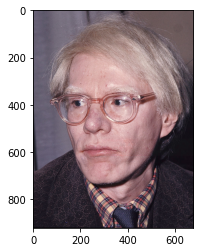

In [ ]:
#single image upload for quick debug
faceURL = 'https://upload.wikimedia.org/wikipedia/commons/4/42/Andy_Warhol_1975.jpg'

from PIL import Image
import requests
from io import BytesIO

response = requests.get(faceURL)
img = Image.open(BytesIO(response.content))
plt.imshow(img)

img.save('testImage.jpg')

img2 = np.asarray(img)
print(img2.shape)

C: Face detection

In [ ]:
Test the dlib HOG face detector on Andy Warhol (person above)

In [ ]:

detector = dlib.get_frontal_face_detector() #HOG face detector
faceRect, scores, idx = detector.run(img2,0,-1)
print(scores)
print(faceRect)

[2.0259804879494134]
rectangles[[(39, 237) (485, 683)]]


Create a function to run the face detector and output the score

In [ ]:
def faceScoreHOG(inputFace):
  detector = dlib.get_frontal_face_detector() #HOG face detector
  
  faceRect, score, idx = detector.run(inputFace,0,-1)
  if not score:
    score = np.asarray([-1,-1]) #this is hacky and I know it
 

  return score[0]


A: Generating a pattern for the mask

Start with random noise

In [ ]:
#temporary placeholder code


import os
import time

import numpy as np
from PIL import Image
 
def create_image(width, height):
    width = int(width)
    height = int(height)

 

    rgb_array = np.floor(np.random.rand(width,height,3)*256).astype(np.uint8)

    return rgb_array

def create_imageBW(width, height):
    width = int(width)
    height = int(height)

 

    bw_array = np.floor(np.random.rand(width,height)*256).astype(np.uint8)

    return bw_array

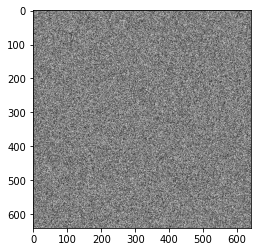

In [ ]:
img3 = create_imageBW(640,640)

plt.imshow(img3,cmap='gray')

Script for making CPPN image

In [ ]:
#making below script into function
import numpy
import matplotlib.pyplot as plt


def cppnImage(WI,W,WO,shift):
  # basic parameters
  seed = None         # PRNG seed
  L = 7               # number of layers
  H = 32              # hidden layer size
  O = 3               # O=3 for RGB, O=1 for grayscale
  nrows = 1024       # height of the output image
  ncols = 1024        # width of the output image

  # construct a 2D array in which each row has numbers between -1.0 and 1.0
  rowmat = (numpy.tile(numpy.linspace(0, nrows-1, nrows, dtype=numpy.float32), ncols).reshape(ncols, nrows).T - nrows/2.0)/(min(nrows, ncols)/2.0) + shift[0]
  # construct a 2D array in which each column has numbers between -1.0 and 1.0
  colmat = (numpy.tile(numpy.linspace(0, ncols-1, ncols, dtype=numpy.float32), nrows).reshape(nrows, ncols)   - ncols/2.0)/(min(nrows, ncols)/2.0) + shift[1]
  # stack the obtained arrays together and reshape the result into a (nrows*ncols)x3 matrix that will be the input to the CPPN
  inputs = [rowmat, colmat, numpy.sqrt(numpy.power(rowmat, 2)+numpy.power(colmat, 2))]
  inputs = numpy.stack(inputs).transpose(1, 2, 0).reshape(-1, len(inputs))
  # init the PRNG seed
  if seed is not None:
  	numpy.random.seed(seed)
  # apply the CPPN
  # (note that we generate its weights on the fly and never store them)
  results = inputs.copy()



  results = numpy.tanh(numpy.matmul(results, WI))

  for i in range(0, L-1):

    results = numpy.tanh(numpy.matmul(results, W[:,:,i]))
   
  results = numpy.tanh(numpy.matmul(results, WO))
  # rescale the input to (0.0, 1.0)
  results = (1 + results)/2.0
  # reshape the result into an image and convert its pixels to uint8 numbers
  results = (255.0*results.reshape(nrows, ncols, results.shape[-1])).astype(numpy.uint8)
  return results

B: Face landmark identification and making an image mask to apply the mask mask

Download the face landmark library for dlib

In [ ]:
!wget http://dlib.net/files/shape_predictor_68_face_landmarks.dat.bz2
!bzip2 -d shape_predictor_68_face_landmarks.dat.bz2


--2020-12-06 18:59:55--  http://dlib.net/files/shape_predictor_68_face_landmarks.dat.bz2
Resolving dlib.net (dlib.net)... 107.180.26.78
Connecting to dlib.net (dlib.net)|107.180.26.78|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 64040097 (61M)
Saving to: ‘shape_predictor_68_face_landmarks.dat.bz2’

shape_predictor_68_ 100%[===================>]  61.07M  18.7MB/s    in 4.2s    

2020-12-06 18:59:59 (14.5 MB/s) - ‘shape_predictor_68_face_landmarks.dat.bz2’ saved [64040097/64040097]



Test out the face landmarks on Andy

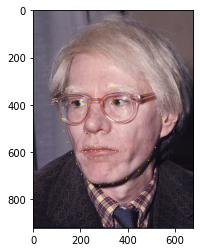

In [ ]:
landmark_detector = dlib.shape_predictor("shape_predictor_68_face_landmarks.dat")
plt.imshow(img2)
landmark_tuple = []
landmarks = []
for k, d in enumerate(faceRect):
   landmarks = landmark_detector(img2, d)
   for n in range(0, 68):
      x = landmarks.part(n).x
      y = landmarks.part(n).y
      landmark_tuple.append((x, y))
      cv2.circle(img2, (x, y), 2, (255, 255, 0), -1)



Test out using face landmarks to make a mask mask

[]
rectangles[]
(rectangles[], [], [])


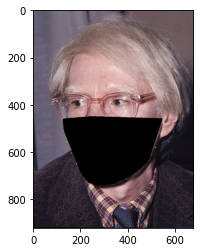

In [ ]:
maskPath = [2,6,7,8,9,10,11,12,15,29,1]

coords = [landmark_tuple[i] for i in maskPath]

mask = np.zeros((img2.shape[0], img2.shape[1]))
mask = cv2.fillConvexPoly(mask, np.array(coords), 1)
mask = mask.astype(np.bool)
mask2 = np.logical_not(mask)

out = np.zeros_like(img2)
out[mask2] = img2[mask2]





plt.imshow(out)


faceRect, scores, idx = detector.run(out,0,0)
print(scores)
print(faceRect)

faceRect = detector.run(out,0)

print(faceRect)

Try using the mask mask to composite a picture of a mask with Andy

[-0.5905570830039557, -0.9856526217924242]
rectangles[[(-86, 199) (627, 841)], [(128, -86) (770, 627)]]


TypeError: ignored

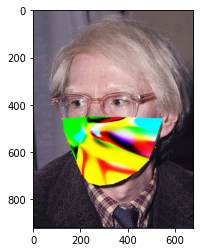

In [ ]:
fillPattern = create_image(img2.shape[0],img2.shape[1]) #dimensions seem switched....

img2Pil = Image.fromarray(img2)

#fillPatternPil = Image.fromarray(fillPattern)
fillPatternPil = Image.fromarray(results)

mask3 = Image.fromarray(mask2)


im = Image.composite(img2Pil, fillPatternPil, mask3)


plt.imshow(im)

imar = np.asarray(im)
faceRect, scores, idx = detector.run(imar,0,-1)
print(scores)
print(faceRect)
faces = np.asarray(faceRect)

#for (x1, y1, x2, y2) in faces: 
    # Draw rectangle around the face
 #   cv2.rectangle(gray, (x1, y1), (x2, y2, (255, 255, 255), 3))



Package that up into a function

In [ ]:
def applyFaceMask(faceImage,maskImage):


  img2Pil = Image.fromarray(faceImage.astype(np.uint8))

  detector = dlib.get_frontal_face_detector() #HOG face detector
  faceRect, score, idx = detector.run(faceImage.astype(np.uint8),0,-1)

  landmark_detector = dlib.shape_predictor("shape_predictor_68_face_landmarks.dat")

  landmark_tuple = []
  landmarks = []
  for k, d in enumerate(faceRect):
   landmarks = landmark_detector(faceImage.astype(np.uint8), d)
   for n in range(0, 68):
      x = landmarks.part(n).x
      y = landmarks.part(n).y
      landmark_tuple.append((x, y))
   






  maskPath = [2,6,7,8,9,10,11,12,15,29,1]

  coords = [landmark_tuple[i] for i in maskPath]

  mask = np.zeros((faceImage.shape[0], faceImage.shape[1]))
  mask = cv2.fillConvexPoly(mask, np.array(coords), 1)
  mask = mask.astype(np.bool)
  mask2 = np.logical_not(mask)





  fillPattern = maskImage.astype(np.uint8)

  

  #fillPatternPil = Image.fromarray(fillPattern)
  fillPatternPil = Image.fromarray(fillPattern)

  mask3 = Image.fromarray(mask2)


  im = Image.composite(img2Pil, fillPatternPil, mask3)



  maskedFace = np.asarray(im)



  return maskedFace

Quick demo to show that a masked baby gives the lowest possible score

-1


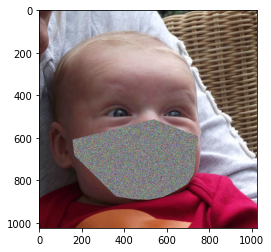

In [ ]:


masked = applyFaceMask(faces[:,:,:,0],genesFullPopulation[:,:,:,4])
plt.imshow(masked)
score = faceScoreHOG(masked)
print(score)

D: supervisor script and genetic algorithm


Reproduction algorithm

In [ ]:
def reproduce(A,B):
  reproductionArray = np.random.rand(*A.shape)>0.5

  C = A*(1.0*reproductionArray)+ B*(1-1.0*reproductionArray)
  D = B*(1.0*reproductionArray)+ A*(1-1.0*reproductionArray)
  return C, D

In [ ]:
#same as above, but with bias term x that shifts towards A or B. x is proportional between 0 and 1
def reproduceB(A,B,x):
  reproductionArray = np.random.rand(*A.shape)>0.5

  C = A*(x*reproductionArray)+ B*(1-x*reproductionArray)
  D = B*(x*reproductionArray)+ A*(1-x*reproductionArray)
  return C, D

Mutation algorithm

In [ ]:
#mutates A by percentage p of genes get edited, x is proportion of shift
def mutate(A,p):
  
  mutationArray = np.random.rand(*A.shape)<p

  newValues = np.random.rand(*A.shape)

  B = A*(1.0*~mutationArray)+ newValues*(1.0*mutationArray)
  return B

Fitness scoring algorithm

In [ ]:
def scorePopulation(faces,genesFullPopulation):
  nPopulation = faces.shape[3]
  nFacesTestPerGen = genesFullPopulation.shape[3]
  scores = np.zeros((nFacesTestPerGen,nPopulation))
  for jj in range(0,nPopulation):
    for ii in range(0,nFacesTestPerGen):
      masked = applyFaceMask(faces[:,:,:,ii],genesFullPopulation[:,:,:,jj])
      scores[ii,jj] = faceScoreHOG(masked)
      
  return scores

#for some reason this isn't working.....

Start with the project using noise as a mask

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 0
best score was 0.3636231101464647
average score was 0.4157095031848965


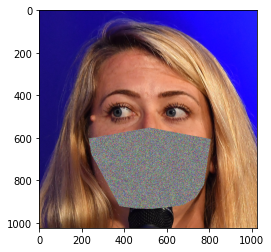

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 1
best score was 0.29508571594073557
average score was 0.38172393807882254


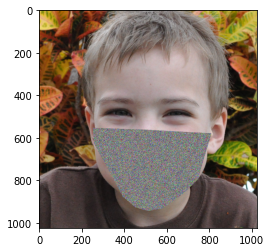

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 2
best score was 0.28792942334328275
average score was 0.3515354769340573


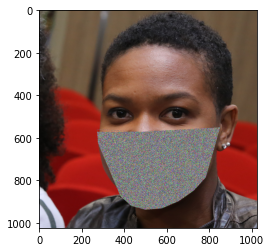

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 3
best score was -0.22843789301529963
average score was -0.0827391539505026


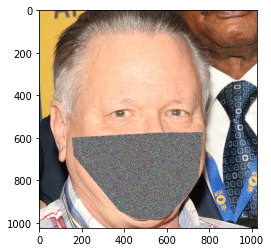

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 4
best score was -0.22843789301529963
average score was -0.12119537832553623


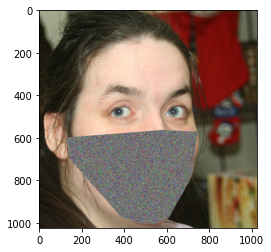

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 5
best score was -0.22843789301529963
average score was -0.13529484711304743


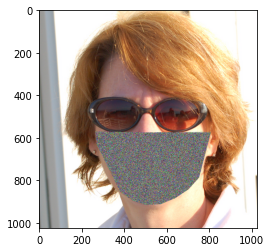

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 6
best score was 0.2511362295363672
average score was 0.31603047769970916


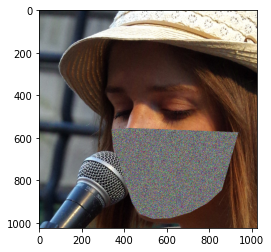

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 7
best score was 0.2511362295363672
average score was 0.2953430800092145


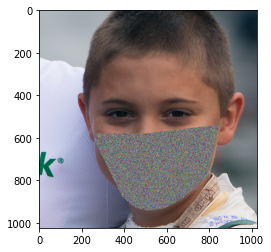

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 8
best score was 0.18845553357298384
average score was 0.2805706946504041


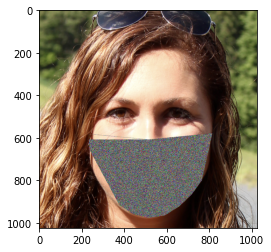

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 9
best score was -0.040923662467425924
average score was 0.0029558820612010832


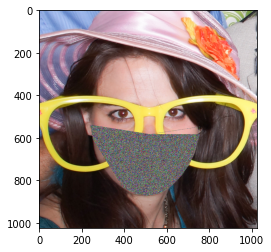

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 10
best score was -0.040923662467425924
average score was -0.011344797892993549


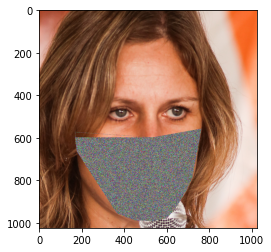

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 11
best score was -0.046315180742368955
average score was -0.025976724906390768


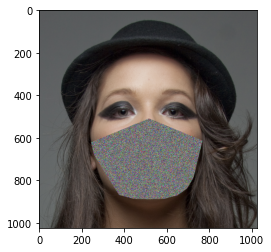

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 12
best score was -0.062227984683316105
average score was -0.02704958162367458


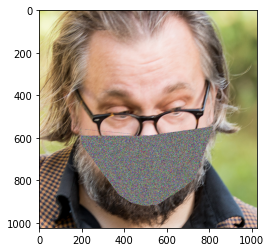

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 13
best score was -0.062227984683316105
average score was -0.03601134012454081


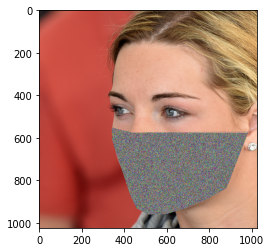

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 14
best score was -0.06793891619529147
average score was -0.04855056940482598


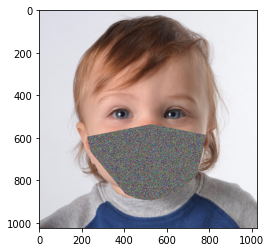

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 15
best score was -0.09788012933175905
average score was -0.01427707504670961


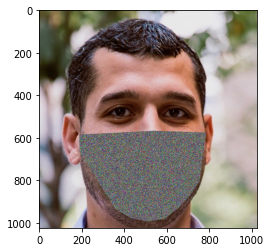

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 16
best score was -0.09788012933175905
average score was -0.04067882330657188


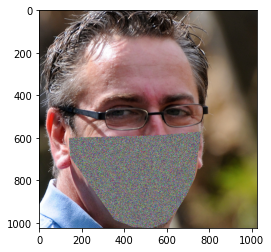

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 17
best score was -0.09788012933175905
average score was -0.05488983225267274


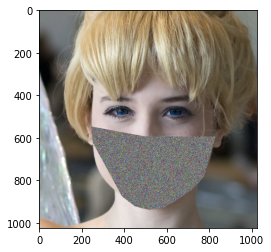

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 18
best score was 0.008023321214714496
average score was 0.09987843988676752


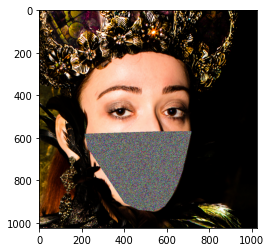

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 19
best score was 0.0106026128762949
average score was 0.0745793974234649


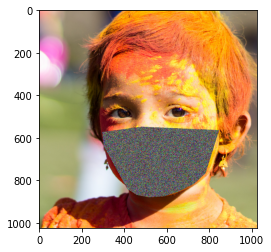

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 20
best score was -0.09776284338692938
average score was 0.049088189585406436


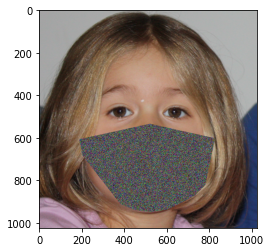

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 21
best score was 0.3492155826942012
average score was 0.4624993956939266


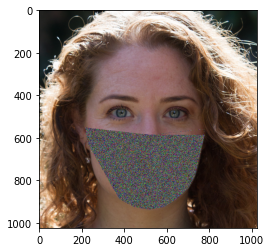

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 22
best score was 0.3492155826942012
average score was 0.43790241647321837


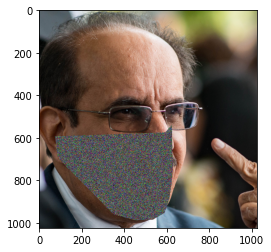

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 23
best score was 0.3709187464769568
average score was 0.41998454499799864


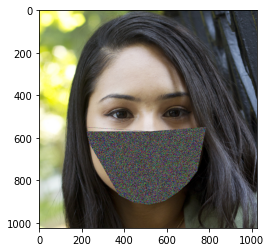

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 24
best score was -0.2836709860110396
average score was -0.24047978154263042


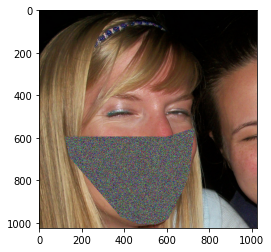

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 25
best score was -0.3241639180127893
average score was -0.25789646736225624


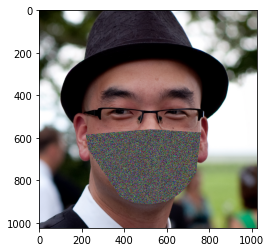

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 26
best score was -0.3241639180127893
average score was -0.26586179367146034


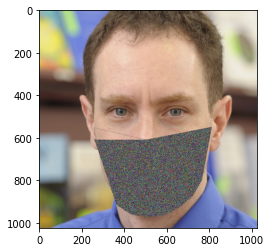

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 27
best score was -0.3373702688106479
average score was -0.21076962581163466


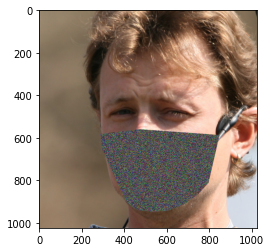

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 28
best score was -0.32688056658591647
average score was -0.2536748869308414


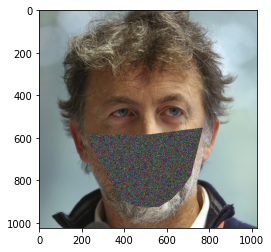

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 29
best score was -0.41872099271303237
average score was -0.293999187458414


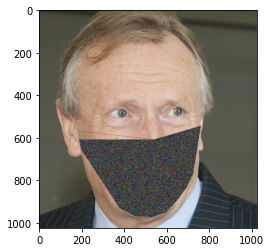

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 30
best score was 0.056906684034398726
average score was 0.089793150901659


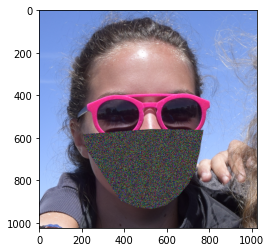

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 31
best score was 0.056906684034398726
average score was 0.08668633974233844


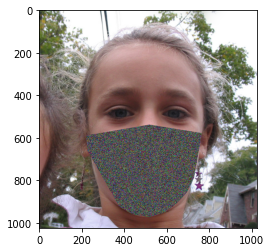

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 32
best score was 0.056906684034398726
average score was 0.09142162926978237


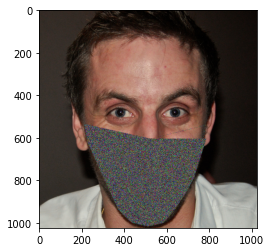

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 33
best score was 0.02345119138918565
average score was 0.054471137328567565


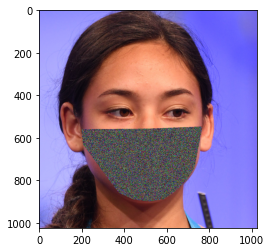

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 34
best score was 0.02345119138918565
average score was 0.04310974697631842


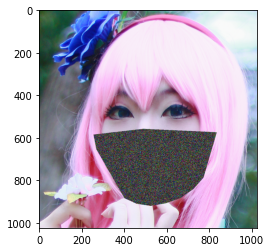

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 35
best score was 0.022483450376612407
average score was 0.03402931710444139


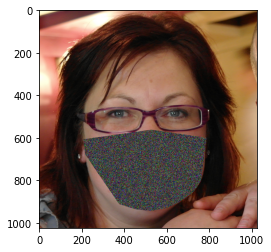

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 36
best score was -0.35746468662358205
average score was -0.30087006647524117


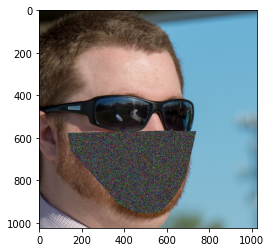

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 37
best score was -0.34925688861943166
average score was -0.31298190910753493


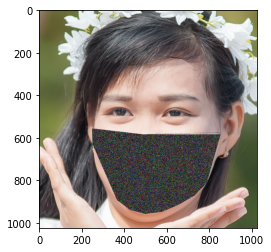

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 38
best score was -0.34925688861943166
average score was -0.3240677074505576


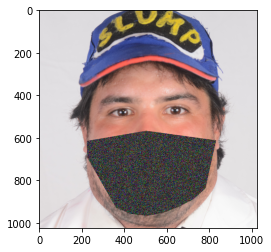

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 39
best score was -0.765267143647628
average score was -0.7214813722274269


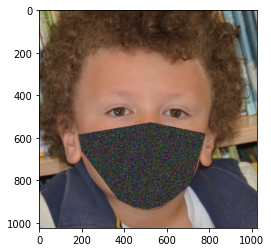

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 40
best score was -0.7658995979886121
average score was -0.7589802499034057


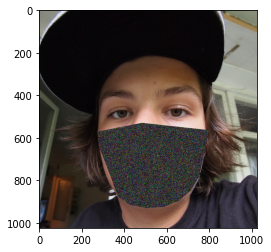

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 41
best score was -0.766746720324487
average score was -0.7572469567674449


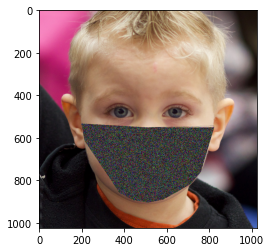

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 42
best score was 0.2575374123366096
average score was 0.31364530095571463


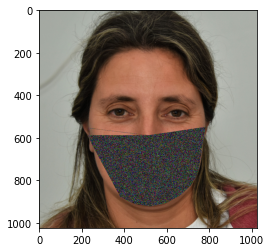

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 43
best score was 0.2517114159376838
average score was 0.2951619701496182


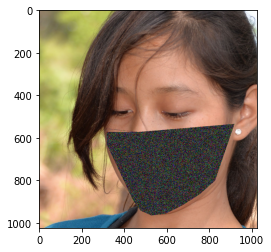

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 44
best score was 0.22919866213315906
average score was 0.2747666216802019


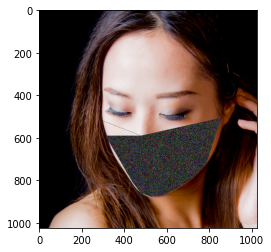

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 45
best score was -0.31097542475547213
average score was -0.27851679316749867


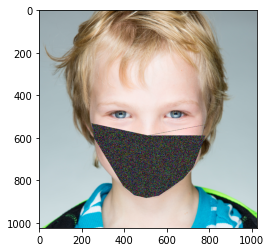

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 46
best score was -0.31948059838672593
average score was -0.2944578646651241


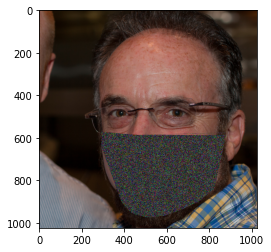

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 47
best score was -0.3241683168300571
average score was -0.29934433786965536


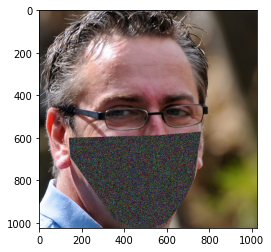

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 48
best score was -0.5188331265291776
average score was -0.506232555612048


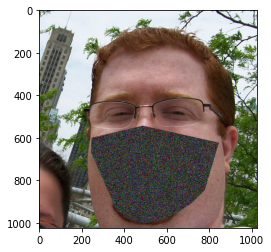

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 49
best score was -0.5436869918347602
average score was -0.5125756024361854


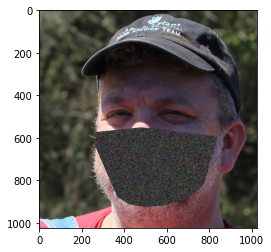

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 50
best score was -0.5436869918347602
average score was -0.5177364507358477


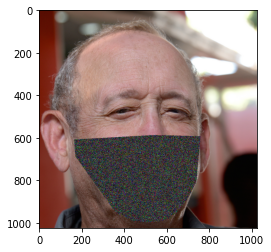

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 51
best score was -0.0266541960923455
average score was 0.009979116609833453


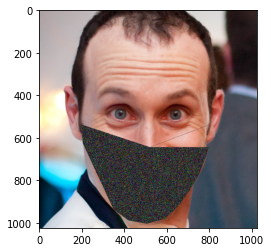

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 52
best score was -0.03183709811057467
average score was -0.011146289417006756


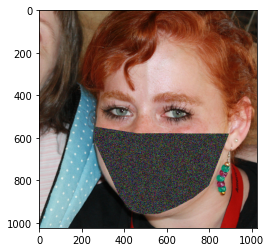

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 53
best score was -0.027985128073750126
average score was -0.016863080172596558


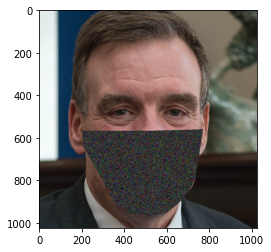

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 54
best score was -0.47786048284059585
average score was -0.45981887011033756


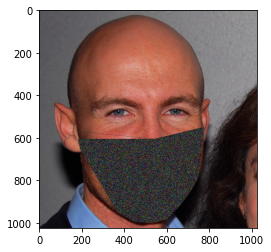

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 55
best score was -0.4811645086341123
average score was -0.4719311472028187


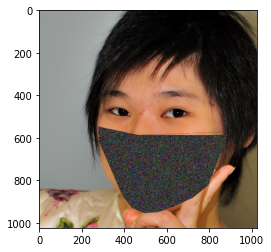

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 56
best score was -0.48145305346335787
average score was -0.4757150911122805


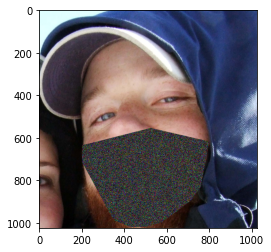

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 57
best score was -0.6562038982134605
average score was -0.6327151779553835


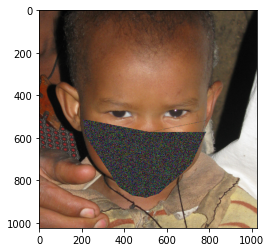

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 58
best score was -0.6565922026059572
average score was -0.6464351439696097


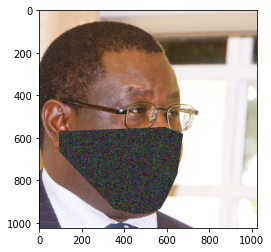

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 59
best score was -0.6565922026059572
average score was -0.6557556911529645


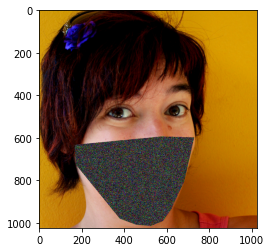

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 60
best score was -0.006184651353525379
average score was 0.005689721604333694


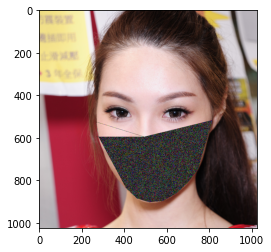

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 61
best score was -0.0071616906906835824
average score was 0.006029303969376027


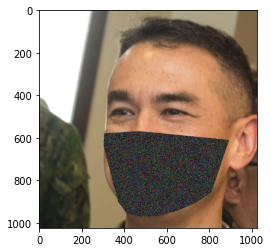

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 62
best score was -0.0059732535467219945
average score was 0.008936173219343035


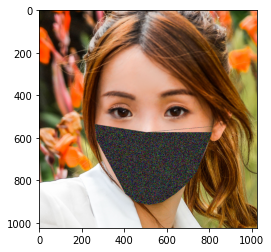

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 63
best score was -0.2294277036299784
average score was -0.22641167880202126


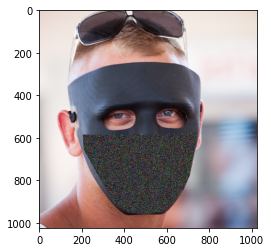

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 64
best score was -0.2312873685469706
average score was -0.21160643141572466


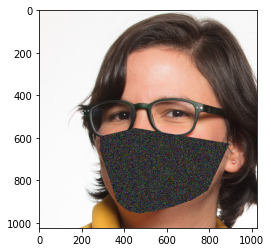

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 65
best score was -0.2315787160506327
average score was -0.2292489194979746


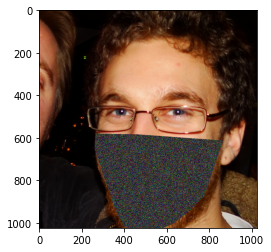

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 66
best score was -0.5409253599312588
average score was -0.5201641184157813


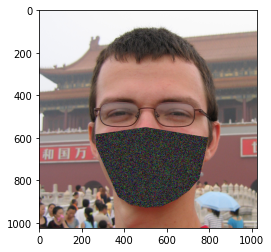

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 67
best score was -0.5409507117735033
average score was -0.5408468109435524


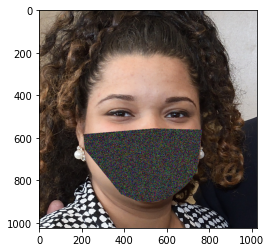

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 68
best score was -0.5409507117735033
average score was -0.5409245453344469


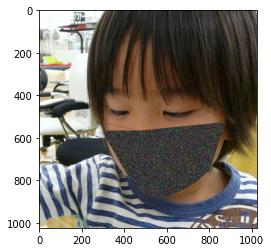

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 69
best score was -0.24179745076677758
average score was -0.24176717160723168


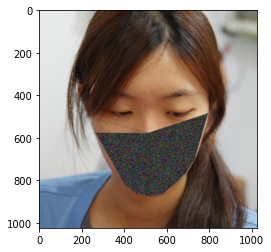

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 70
best score was -0.24179745076677758
average score was -0.23468032835504968


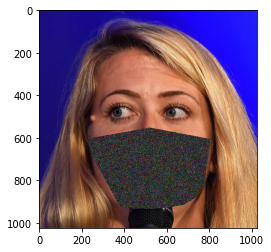

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 71
best score was -0.24179745076677758
average score was -0.24179745076677758


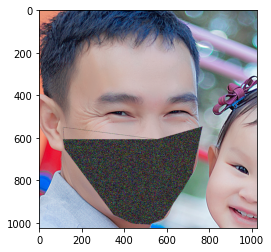

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 72
best score was -0.6414644008123319
average score was -0.6364316726966144


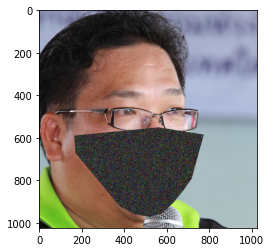

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 73
best score was -0.6414644008123319
average score was -0.6414639835798185


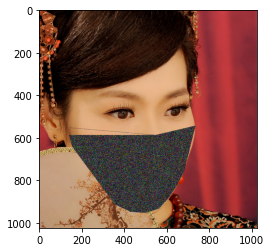

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 74
best score was -0.6414644008123319
average score was -0.6414644008123319


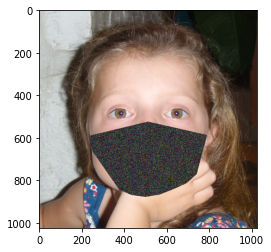

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 75
best score was -0.4468336586267232
average score was -0.4344165309379974


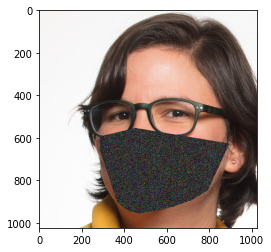

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 76
best score was -0.4468336586267232
average score was -0.44035790206099346


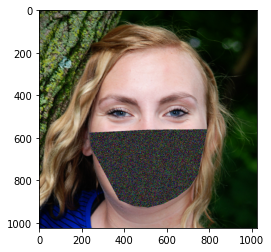

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 77
best score was -0.4468336586267232
average score was -0.4468336586267232


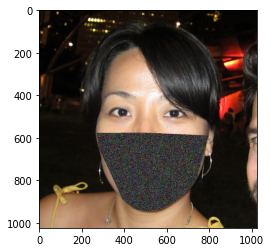

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 78
best score was -0.4321812154915616
average score was -0.4321812154915616


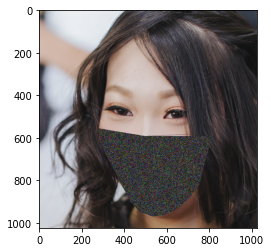

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 79
best score was -0.4321812154915616
average score was -0.4233315251337175


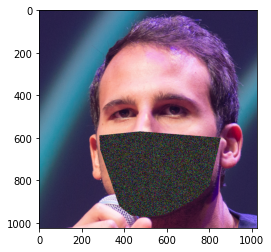

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 80
best score was -0.4321812154915616
average score was -0.4321812154915616


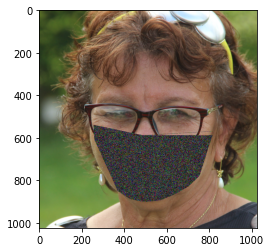

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 81
best score was -0.19178176919694442
average score was -0.19012083609974084


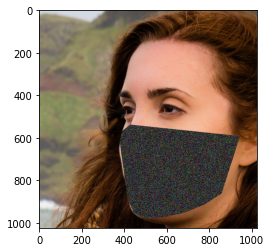

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 82
best score was -0.19744301835771103
average score was -0.18594936529870526


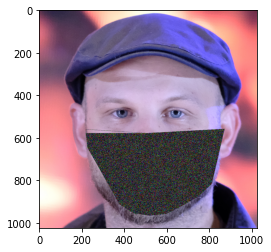

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 83
best score was -0.19178176919694442
average score was -0.18433862924651004


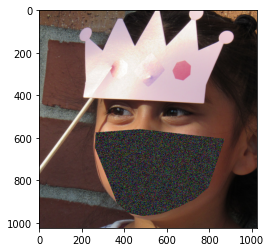

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 84
best score was -0.22340674431011895
average score was -0.17729158432171563


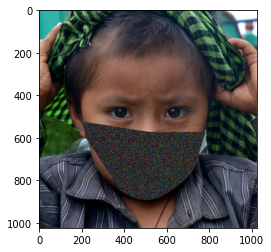

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 85
best score was -0.22340674431011895
average score was -0.21129389833297152


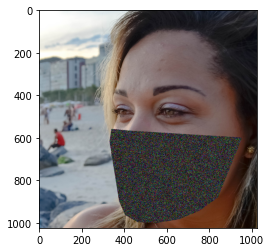

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 86
best score was -0.22340674431011895
average score was -0.22340674431011895


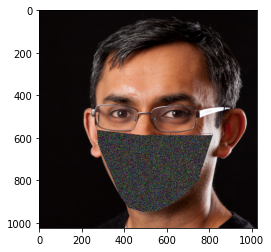

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 87
best score was -0.258711781009158
average score was -0.258711781009158


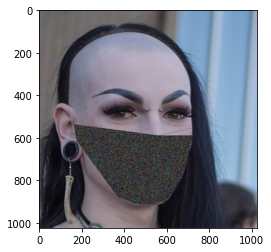

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 88
best score was -0.258711781009158
average score was -0.258711781009158


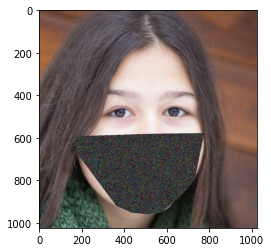

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 89
best score was -0.258711781009158
average score was -0.258711781009158


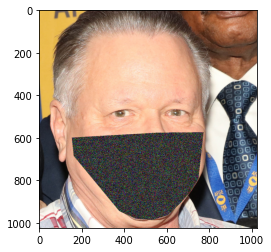

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 90
best score was -0.4080868604922408
average score was -0.4080868604922408


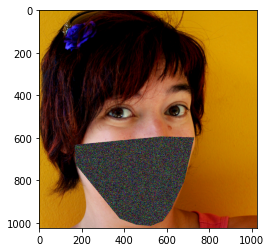

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 91
best score was -0.4080868604922408
average score was -0.4080868604922408


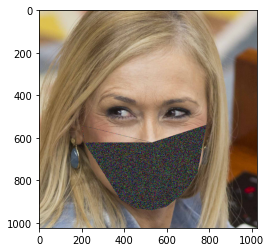

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 92
best score was -0.4080868604922408
average score was -0.3775081578040237


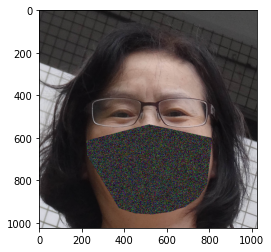

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 93
best score was -0.3302047455475739
average score was -0.3302047455475739


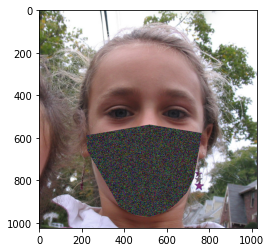

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 94
best score was -0.4279970530833812
average score was -0.3344671730365367


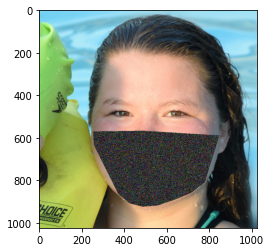

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 95
best score was -0.4279970530833812
average score was -0.35917011938154814


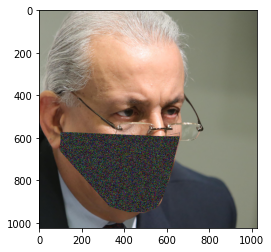

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 96
best score was -0.02390969635153602
average score was 0.008805425553472931


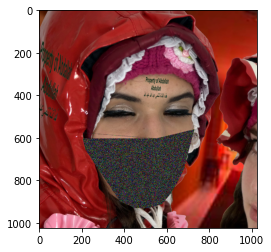

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 97
best score was -0.053181219509291555
average score was -0.013486185084827646


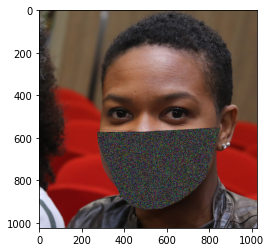

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 98
best score was -0.02390969635153602
average score was -0.010438271771915659


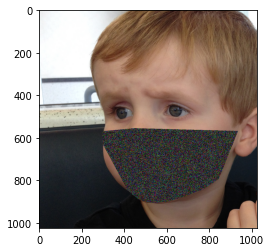

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 99
best score was -0.24194919298972506
average score was -0.2137071314542077


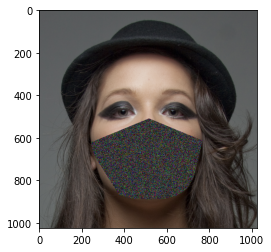

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 100
best score was -0.24194919298972506
average score was -0.2187315447219791


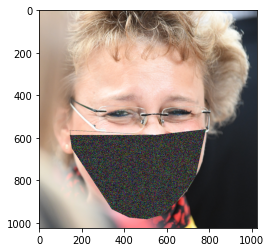

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 101
best score was -0.264524253516255
average score was -0.23332296044514395


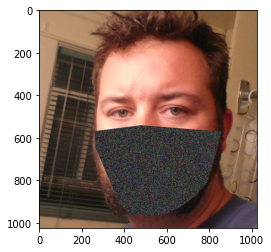

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 102
best score was -0.8768214046002631
average score was -0.8669665753424087


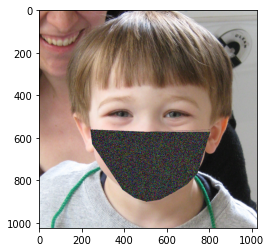

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 103
best score was -0.8768214046002631
average score was -0.8731880003656189


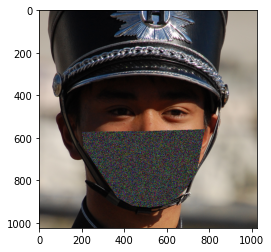

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 104
best score was -0.8760652203402127
average score was -0.8731587344850342


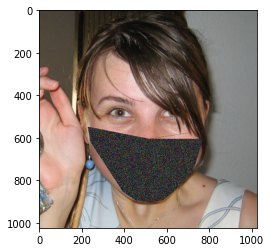

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 105
best score was 0.0941813305903992
average score was 0.12332186260715336


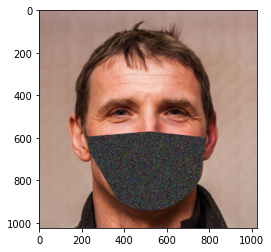

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 106
best score was 0.10244475959633996
average score was 0.12690994301334232


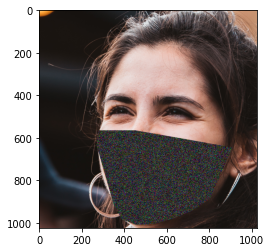

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 107
best score was 0.10244475959633996
average score was 0.11211774904425154


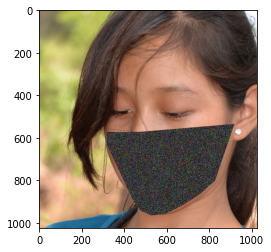

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 108
best score was -0.3935944400297289
average score was -0.38728659968243884


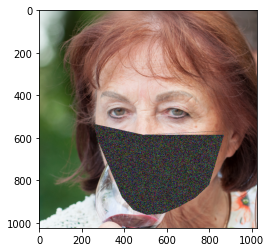

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 109
best score was -0.39569657664166735
average score was -0.390683826016057


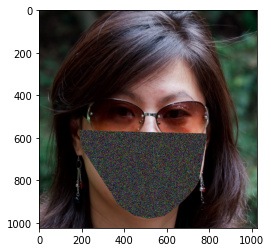

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 110
best score was -0.39569657664166735
average score was -0.39334818343983935


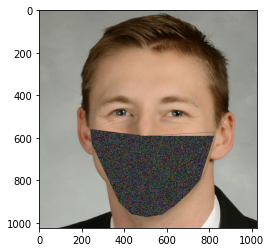

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 111
best score was -0.18640844771646417
average score was -0.18418285001698093


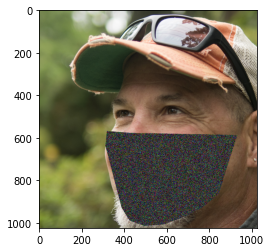

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 112
best score was -0.18640844771646417
average score was -0.1855939601797159


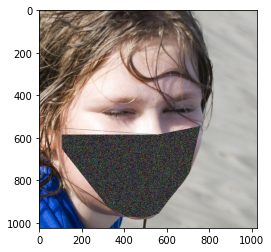

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 113
best score was -0.18787146359069107
average score was -0.1859311734575327


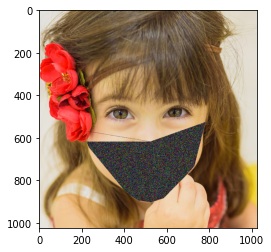

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 114
best score was -0.6325761933168973
average score was -0.6293171305498684


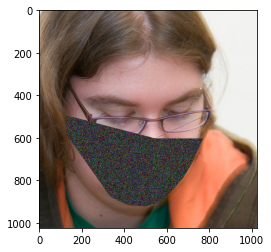

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 115
best score was -0.6325761933168973
average score was -0.630725071732323


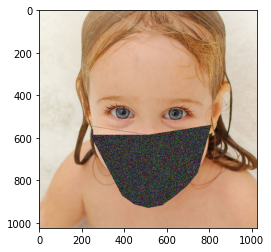

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 116
best score was -0.6325837432385688
average score was -0.6317137935798571


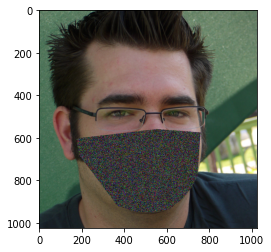

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 117
best score was -0.43017905919552374
average score was -0.4082111911853207


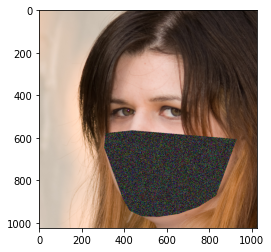

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 118
best score was -0.43269572624366015
average score was -0.39999823737939727


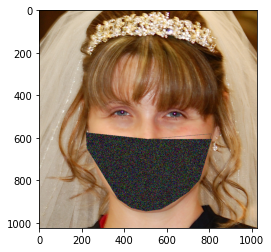

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 119
best score was -0.43269572624366015
average score was -0.41004049746990734


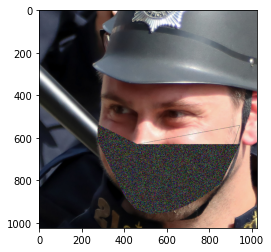

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 120
best score was -0.3377504669714552
average score was -0.32289390992011446


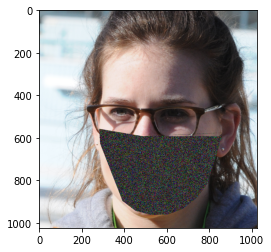

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 121
best score was -0.3758666041581414
average score was -0.34147507181650216


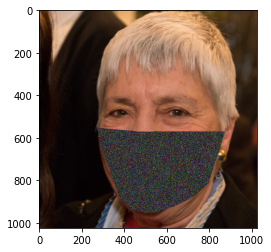

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 122
best score was -0.37197346717999197
average score was -0.33295026650911386


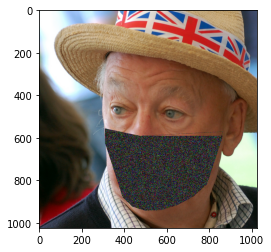

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 123
best score was -0.7798664890814405
average score was -0.7526336633253676


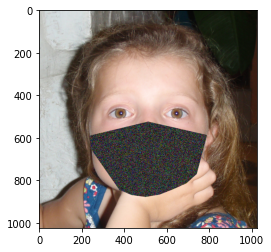

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 124
best score was -0.7645316444922071
average score was -0.7452513379813079


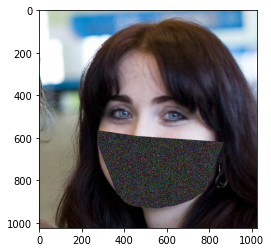

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 125
best score was -0.7657616459417921
average score was -0.7579838755814812


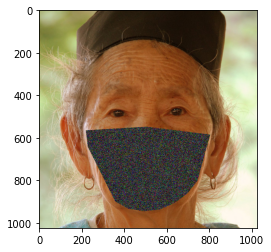

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 126
best score was -0.0958395165271247
average score was -0.07648869972096728


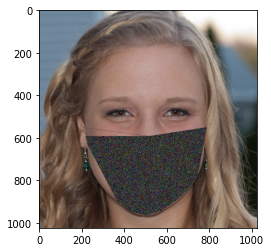

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 127
best score was -0.0958395165271247
average score was -0.07956698160039233


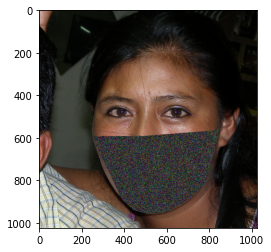

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 128
best score was -0.10097497324811266
average score was -0.08930148304171212


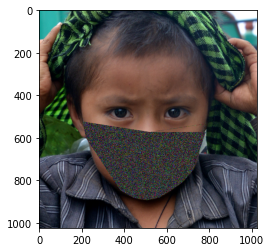

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 129
best score was -0.499136241583882
average score was -0.4783983551550489


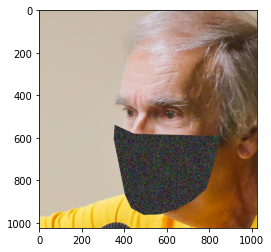

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 130
best score was -0.5124037586737257
average score was -0.4877314590502363


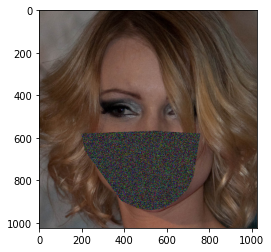

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 131
best score was -0.5124037586737257
average score was -0.49924845726177913


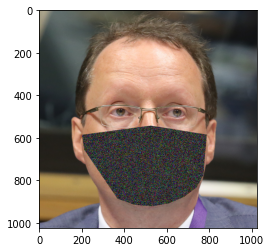

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 132
best score was -0.23560996086285332
average score was -0.23106091450538058


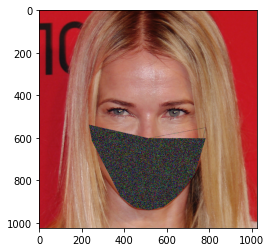

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 133
best score was -0.2359884900936069
average score was -0.233813089439132


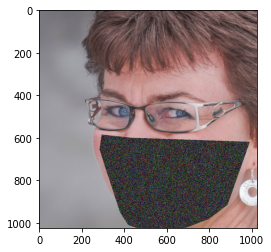

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 134
best score was -0.2359129114040317
average score was -0.22911580633010287


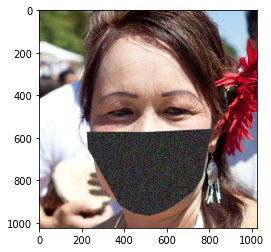

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 135
best score was -0.4517457806158644
average score was -0.4477947277912082


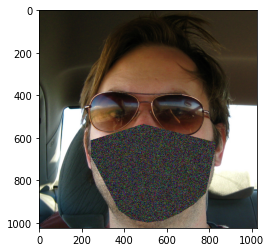

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 136
best score was -0.45212311775372244
average score was -0.4498599194574934


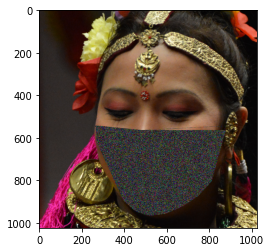

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 137
best score was -0.45498946538454116
average score was -0.4508215112575473


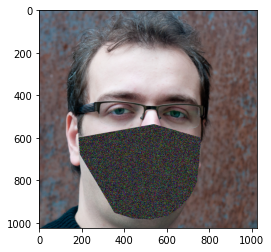

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 138
best score was -0.33648666174651326
average score was -0.3337670607511316


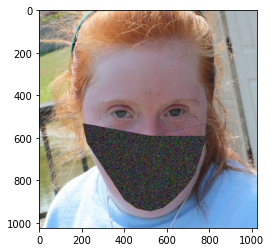

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 139
best score was -0.33648666174651326
average score was -0.3345885915700708


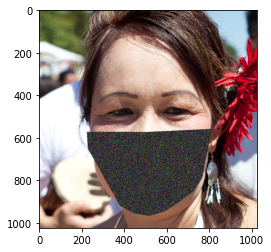

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 140
best score was -0.3365043841942265
average score was -0.33598809869528956


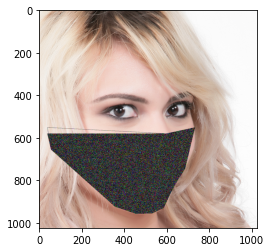

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 141
best score was -0.324568876039036
average score was -0.32446208438381346


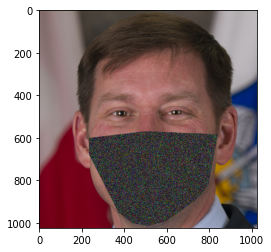

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 142
best score was -0.324568876039036
average score was -0.3245621605823913


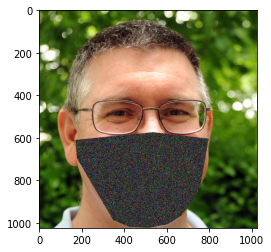

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 143
best score was -0.3439376557038239
average score was -0.3269877879934927


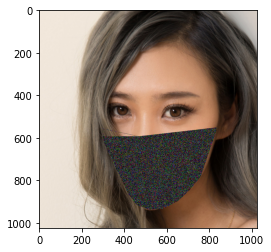

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 144
best score was -0.6692650752257424
average score was -0.6458659389866939


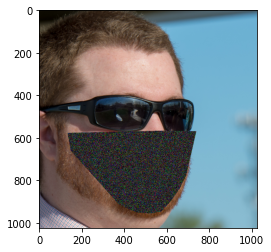

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 145
best score was -0.6723191822810413
average score was -0.6508512827960776


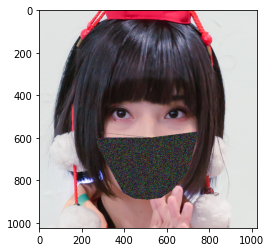

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 146
best score was -0.6896709407666299
average score was -0.6592757358398644


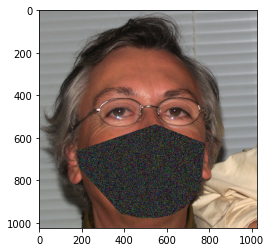

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 147
best score was -0.6454611376835593
average score was -0.6269528722677318


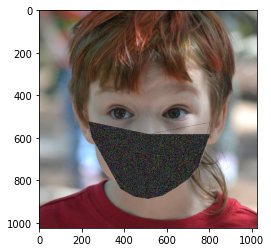

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 148
best score was -0.6524599150730857
average score was -0.6291841806022691


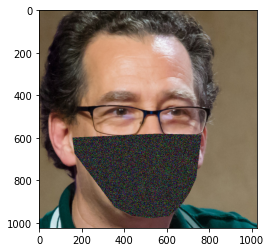

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 149
best score was -0.6524599150730857
average score was -0.6374266898546307


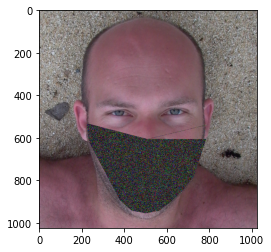

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 150
best score was -0.6427967487758073
average score was -0.6261378764098557


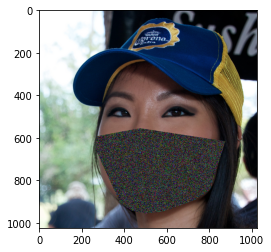

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 151
best score was -0.6538089850530696
average score was -0.6333960929498744


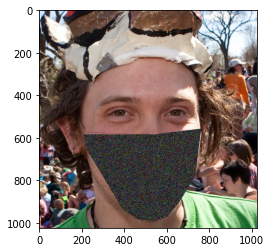

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 152
best score was -0.6538089850530696
average score was -0.6367218632485143


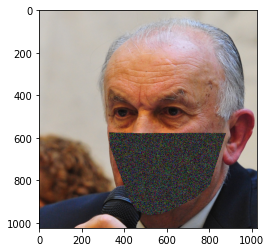

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 153
best score was -0.018777799913146282
average score was -0.0007247451035759704


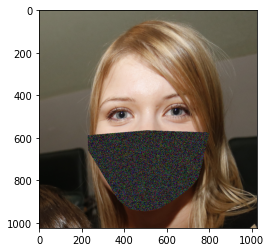

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 154
best score was -0.018777799913146282
average score was -0.008550209113814617


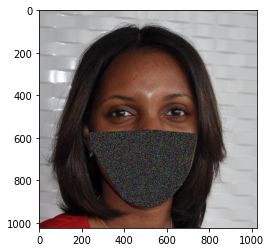

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 155
best score was -0.025184027660745567
average score was 0.0030142542631842843


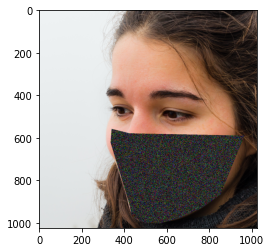

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 156
best score was -0.4909538470848515
average score was -0.47297676832915486


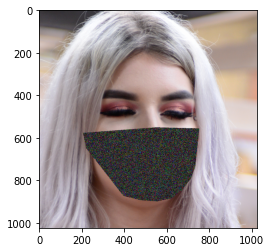

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 157
best score was -0.4909538470848515
average score was -0.47790154249907674


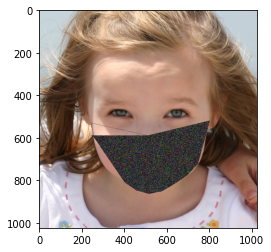

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 158
best score was -0.49129756720305623
average score was -0.4739956799292678


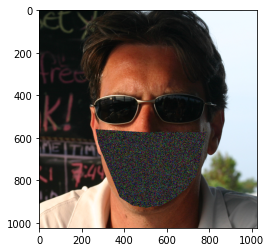

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 159
best score was -0.6199994290039949
average score was -0.5889913642571382


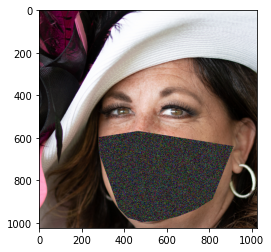

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 160
best score was -0.6247581843700023
average score was -0.6055653496748221


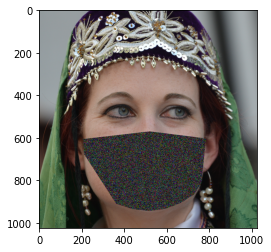

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 161
best score was -0.6247581843700023
average score was -0.6188884778982413


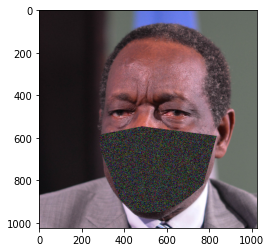

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 162
best score was -0.5161953691861574
average score was -0.5045151099170004


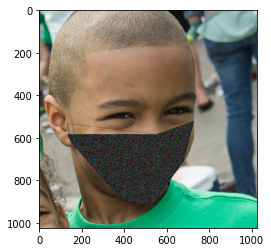

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 163
best score was -0.5248839939875842
average score was -0.5140925968547891


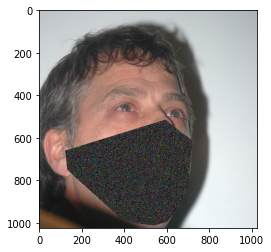

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 164
best score was -0.5351544145963136
average score was -0.519348359552723


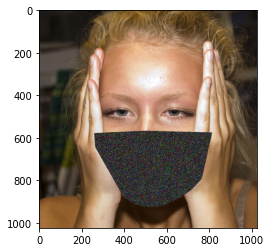

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 165
best score was -0.23312077961027736
average score was -0.22663996258482705


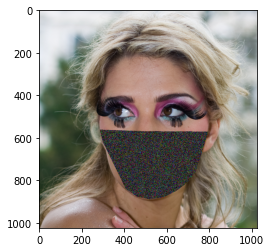

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 166
best score was -0.23385781091114
average score was -0.23170473019662244


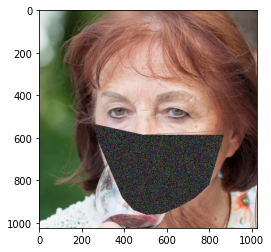

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 167
best score was -0.23917963148812568
average score was -0.23269853037258104


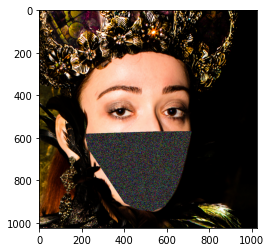

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 168
best score was -0.42347038378727486
average score was -0.4162354031246111


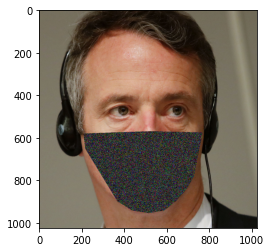

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 169
best score was -0.4252175946077908
average score was -0.4205329178811317


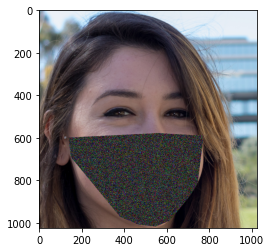

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 170
best score was -0.4252175946077908
average score was -0.4227672675292894


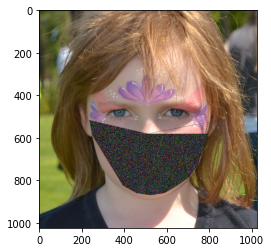

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 171
best score was -0.5936858578743084
average score was -0.5913101359428509


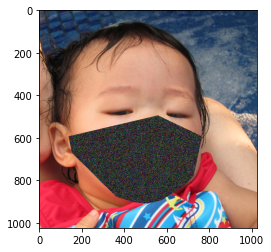

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 172
best score was -0.5942039414466961
average score was -0.5925769333264772


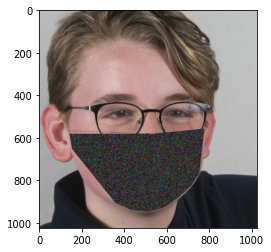

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 173
best score was -0.5942203128557945
average score was -0.5886248274864301


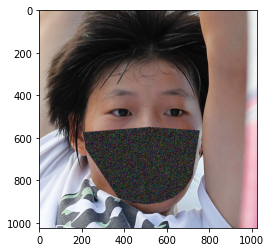

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 174
best score was -0.17370240322193645
average score was -0.1624646527711664


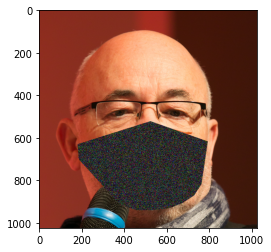

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 175
best score was -0.17387056779306276
average score was -0.17257477274975322


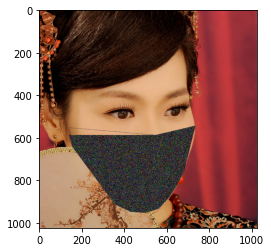

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 176
best score was -0.17394423913400514
average score was -0.17299670409601076


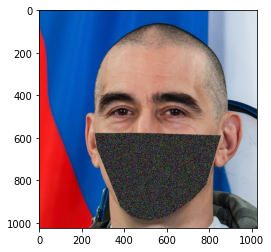

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 177
best score was -0.5832955761970623
average score was -0.5823598925492708


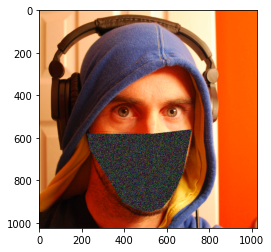

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 178
best score was -0.5833268090309246
average score was -0.5831732774000906


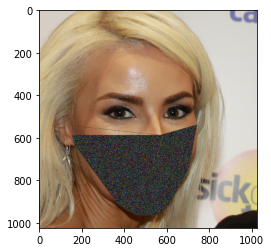

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 179
best score was -0.5833268090309246
average score was -0.5701318506619875


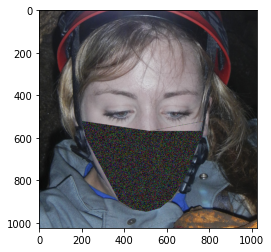

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 180
best score was -0.2378202920290208
average score was -0.2378202920290208


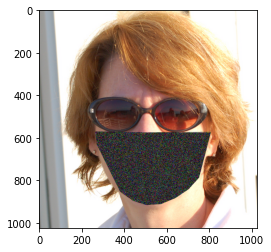

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 181
best score was -0.2378202920290208
average score was -0.2378202920290208


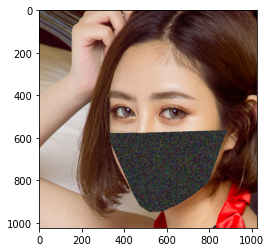

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 182
best score was -0.2478058700946876
average score was -0.23906848928722915


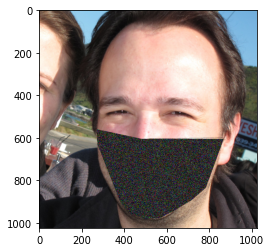

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 183
best score was -0.017393494162199524
average score was -0.006712570302921161


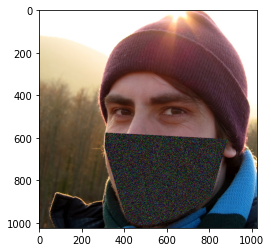

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 184
best score was -0.017393494162199524
average score was -0.017393196138975647


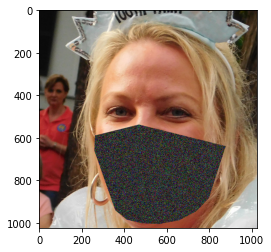

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 185
best score was -0.017393494162199524
average score was -0.016869469993549213


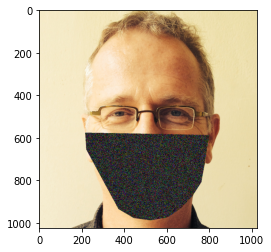

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 186
best score was -0.6660930240374351
average score was -0.6545805259765729


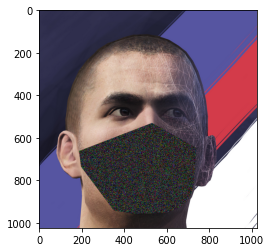

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 187
best score was -0.6660930240374351
average score was -0.651434682232295


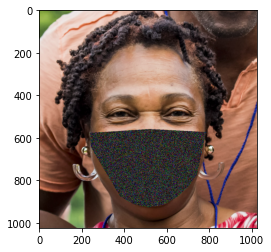

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 188
best score was -0.6660930240374351
average score was -0.6660930240374351


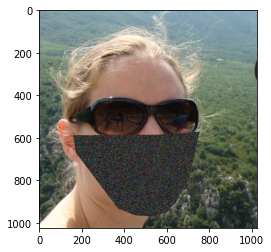

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 189
best score was -0.1147016887034984
average score was -0.1147016887034984


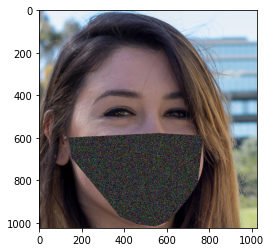

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 190
best score was -0.1147016887034984
average score was -0.1147016887034984


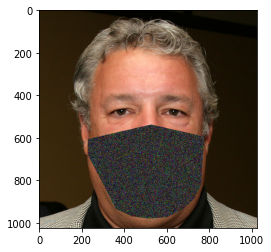

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 191
best score was -0.1147016887034984
average score was -0.10418215435405687


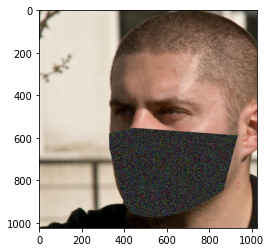

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 192
best score was -0.2509791775764569
average score was -0.2509791775764569


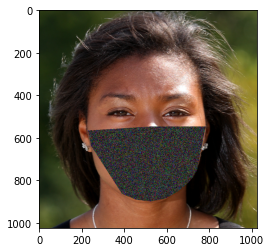

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 193
best score was -0.2509791775764569
average score was -0.24966026734181895


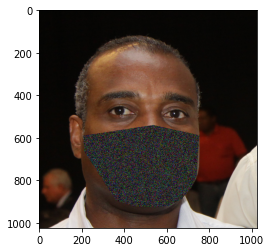

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 194
best score was -0.2509791775764569
average score was -0.2509791775764569


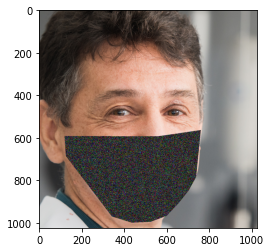

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 195
best score was -0.24339701773385322
average score was -0.24266728800197557


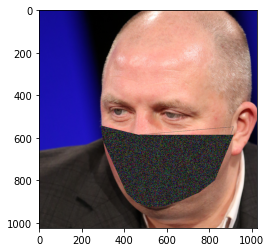

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 196
best score was -0.24339701773385322
average score was -0.2426118755505494


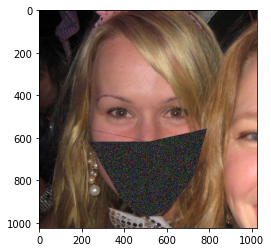

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 197
best score was -0.24339701773385322
average score was -0.24339701773385322


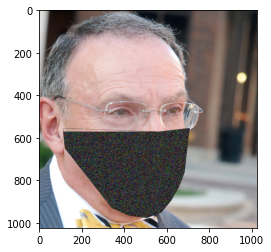

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 198
best score was -0.3162594162512404
average score was -0.3162594162512404


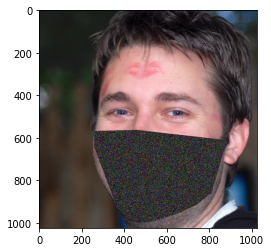

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 199
best score was -0.3162594162512404
average score was -0.307218343836393


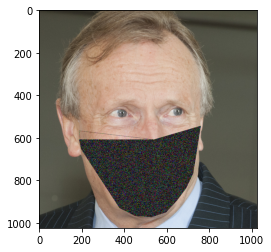

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 200
best score was -0.3162594162512404
average score was -0.3162594162512404


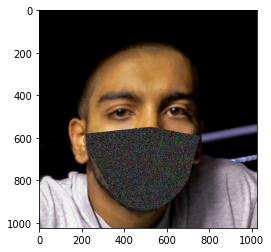

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 201
best score was -0.5821815652736606
average score was -0.5821815652736606


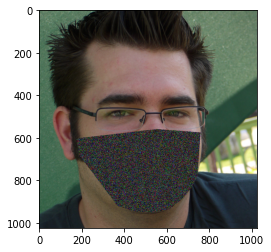

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 202
best score was -0.5821815652736606
average score was -0.579404068299987


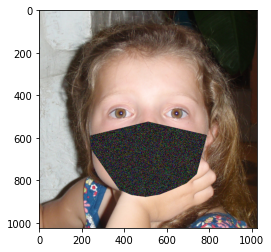

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 203
best score was -0.5821815652736606
average score was -0.5795363111385288


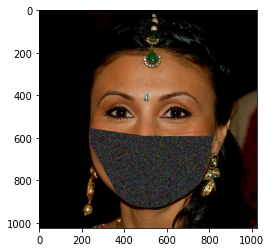

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 204
best score was -0.4607490797845095
average score was -0.4607490797845095


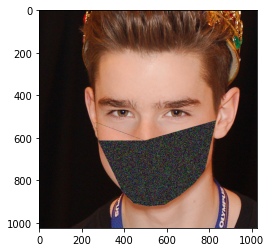

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 205
best score was -0.4607490797845095
average score was -0.4607490797845095


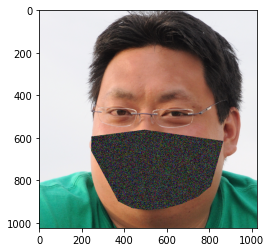

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 206
best score was -0.4607490797845095
average score was -0.4607490797845095


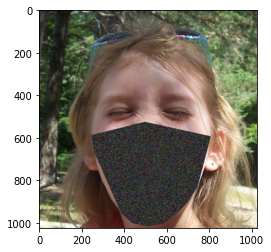

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 207
best score was -0.4286472958392585
average score was -0.4158254724807227


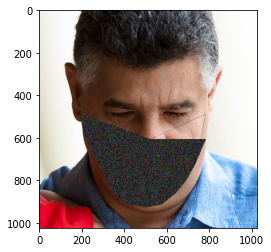

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 208
best score was -0.42161711485625447
average score was -0.4025531358720226


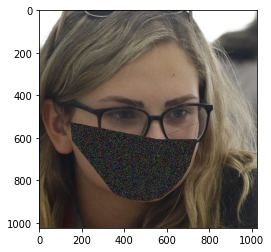

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 209
best score was -0.41606904686159735
average score was -0.4031333175501588


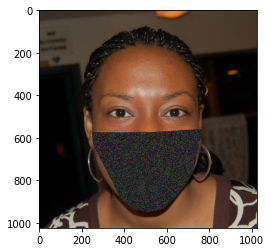

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 210
best score was -0.24489820517651703
average score was -0.2300810467953728


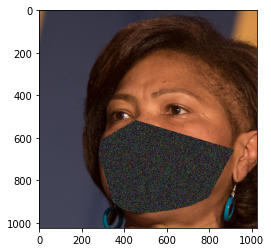

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 211
best score was -0.24489820517651703
average score was -0.22529049235137766


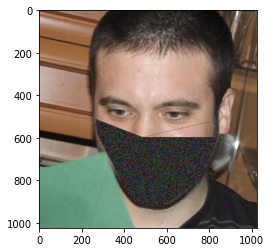

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 212
best score was -0.24609737115653818
average score was -0.2268683961784091


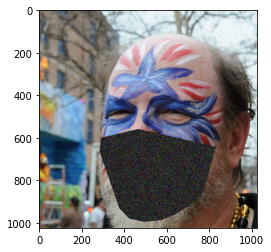

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 213
best score was -0.32650279245987973
average score was -0.2679584249080761


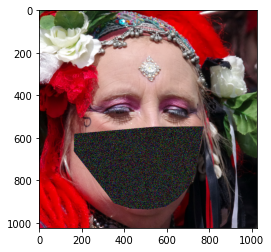

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 214
best score was -0.32650279245987973
average score was -0.2762494309963329


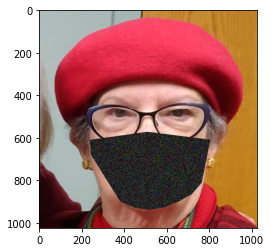

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 215
best score was -0.3340412700396323
average score was -0.28506770970638035


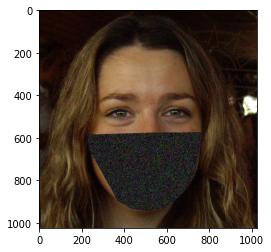

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 216
best score was -0.46013419262012983
average score was -0.3980962180241063


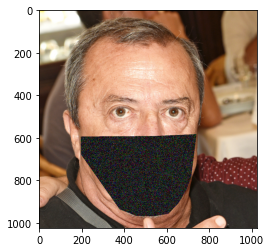

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 217
best score was -0.46013419262012983
average score was -0.41996747683923585


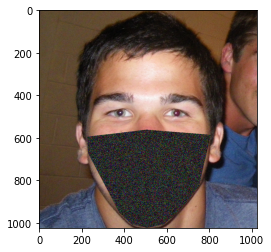

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 218
best score was -0.46013419262012983
average score was -0.41643014978807313


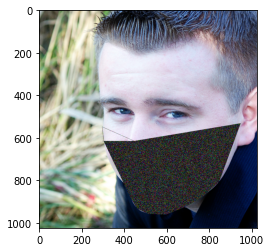

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 219
best score was -0.2622559782798673
average score was -0.2010119574204669


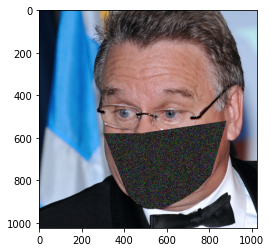

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 220
best score was -0.26235706775740636
average score was -0.22592171758086738


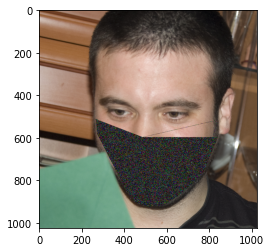

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 221
best score was -0.2809033080051819
average score was -0.24651627596792688


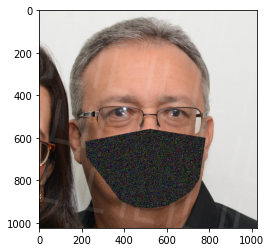

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 222
best score was 0.05053845612763223
average score was 0.09554250606456256


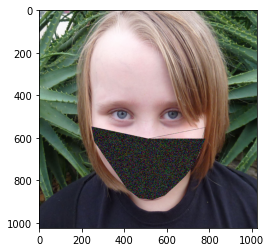

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 223
best score was 0.059931035524197984
average score was 0.09892089733043172


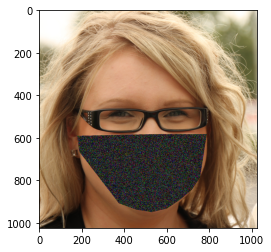

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 224
best score was 0.059931035524197984
average score was 0.08594170777558144


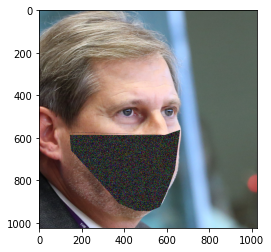

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 225
best score was -0.7443116541562632
average score was -0.7090912794925924


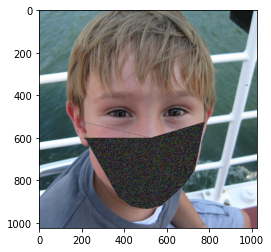

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 226
best score was -0.7443116541562632
average score was -0.7321489588278687


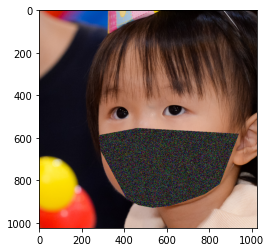

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 227
best score was -0.755368633653537
average score was -0.7366600866971569


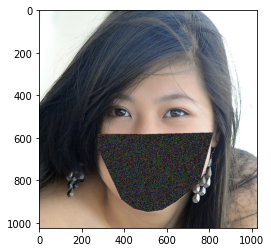

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 228
best score was -0.5447973071576362
average score was -0.5359640676817501


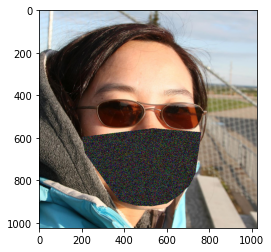

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 229
best score was -0.5443188010693794
average score was -0.5340630669436062


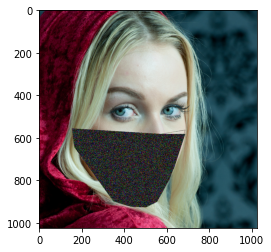

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 230
best score was -0.5448793231488471
average score was -0.5324754607864963


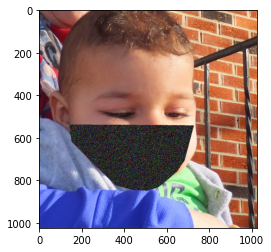

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 231
best score was -0.1433547498848721
average score was -0.1370834968553667


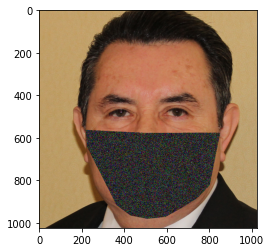

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 232
best score was -0.1441779297656501
average score was -0.13993421813514675


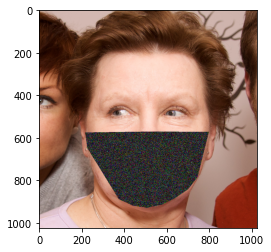

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 233
best score was -0.14463052770164456
average score was -0.14263309658236153


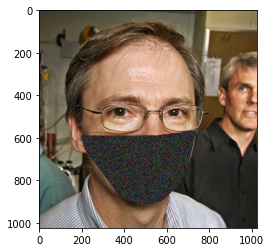

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 234
best score was -0.3418844861873569
average score was -0.33308374911157734


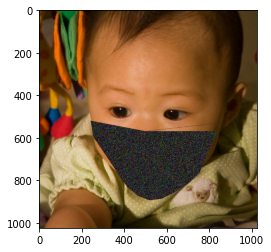

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 235
best score was -0.34204669029400564
average score was -0.3413284344562473


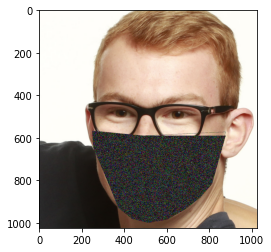

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 236
best score was -0.34204669029400564
average score was -0.3418198350159905


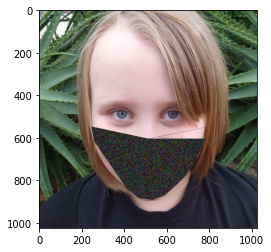

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 237
best score was -0.5584786650474455
average score was -0.5520037826831723


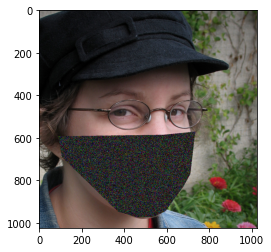

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 238
best score was -0.5604122397239591
average score was -0.5533575333094185


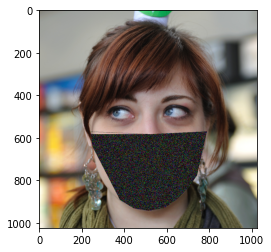

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 239
best score was -0.562514535281617
average score was -0.5557369109924222


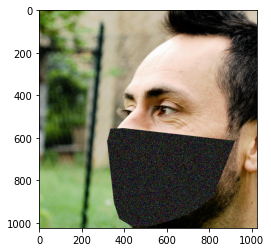

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 240
best score was -0.3785750274028392
average score was -0.3420945836997682


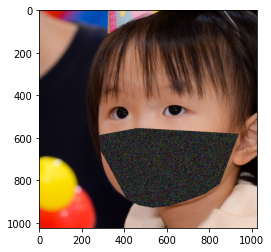

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 241
best score was -0.4019312384812615
average score was -0.34850120330776946


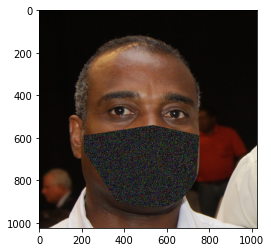

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 242
best score was -0.4236790541972728
average score was -0.3689871011667071


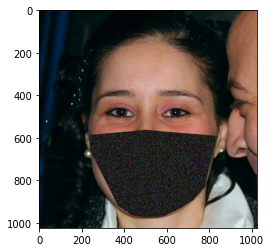

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 243
best score was -0.33365623584827925
average score was -0.30817547223341196


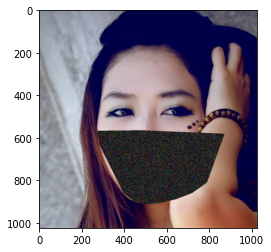

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 244
best score was -0.33365623584827925
average score was -0.3178248150293146


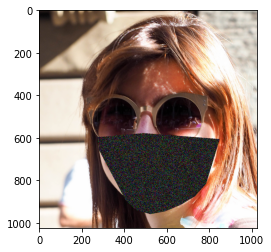

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 245
best score was -0.3680439832949752
average score was -0.3192611876273269


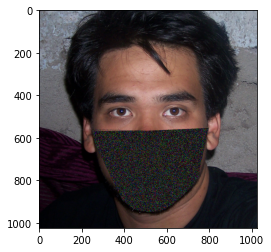

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 246
best score was -0.5989684363213748
average score was -0.5729870863902738


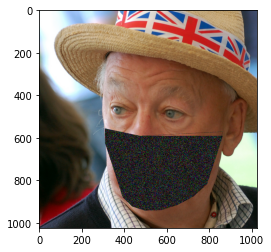

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 247
best score was -0.5989684363213748
average score was -0.5804542601116072


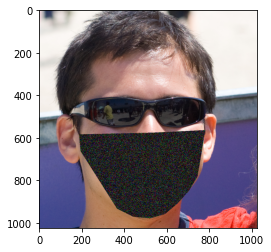

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 248
best score was -0.6010210613417198
average score was -0.5851824152616829


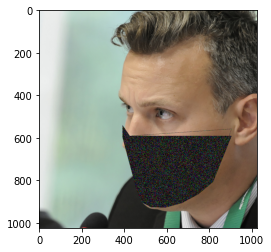

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 249
best score was -0.43687903117026705
average score was -0.41789635251845736


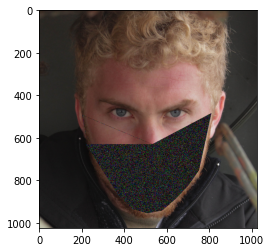

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 250
best score was -0.45634797444826186
average score was -0.4330184283940575


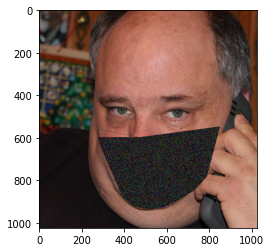

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 251
best score was -0.45634797444826186
average score was -0.43429921300099117


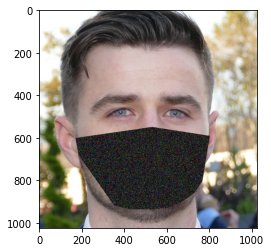

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 252
best score was -0.3322092727679169
average score was -0.31024792153220926


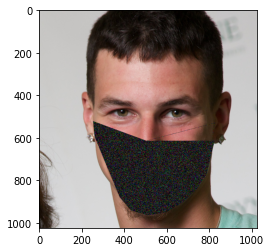

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 253
best score was -0.3322092727679169
average score was -0.31586871900738833


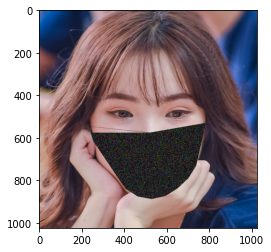

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 254
best score was -0.3363189732887502
average score was -0.3181988433855927


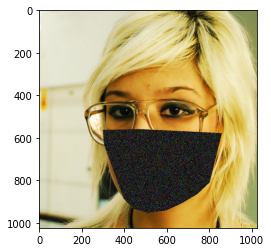

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 255
best score was -0.5659283436329283
average score was -0.5576415198039132


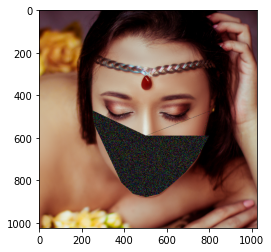

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 256
best score was -0.5659283436329283
average score was -0.561554038225722


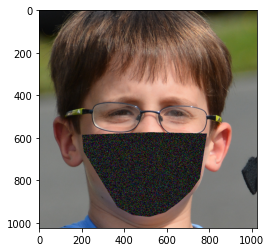

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 257
best score was -0.5659033891549824
average score was -0.5642224984358865


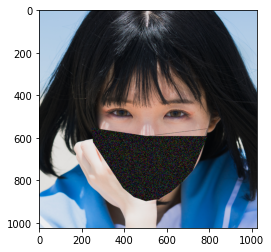

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 258
best score was -0.6001605905031746
average score was -0.5853172239119413


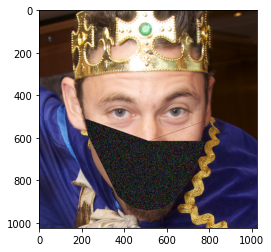

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 259
best score was -0.6017836932506175
average score was -0.5940172533741394


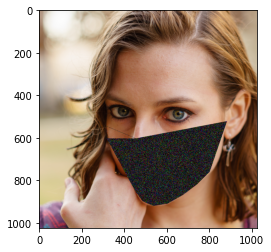

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 260
best score was -0.6017836932506175
average score was -0.5951322214260302


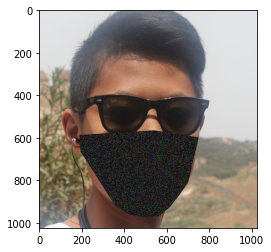

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 261
best score was -0.5529578729635488
average score was -0.53377063117087


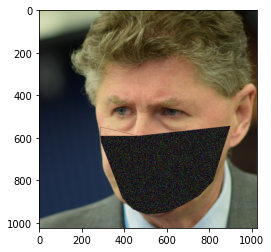

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 262
best score was -0.5657243931458406
average score was -0.5327442093855155


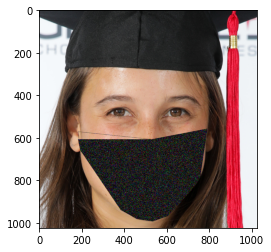

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 263
best score was -0.5663111412690095
average score was -0.5486197674439363


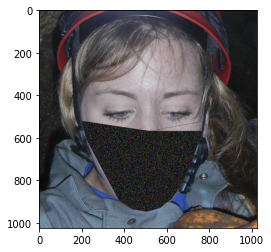

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 264
best score was -0.15643120168230493
average score was -0.14732763527414758


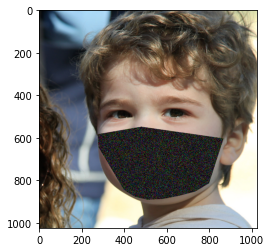

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 265
best score was -0.15643120168230493
average score was -0.15408383169354556


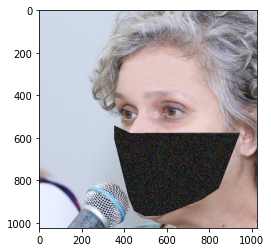

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 266
best score was -0.15643120168230493
average score was -0.1557895676154053


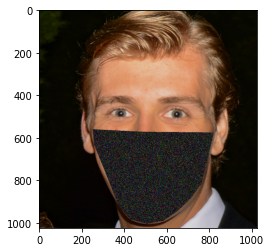

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 267
best score was -0.1764397823975495
average score was -0.17555485210478422


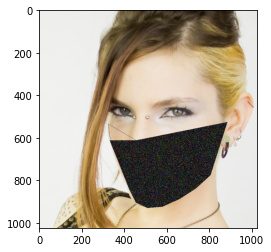

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 268
best score was -0.17700968227446193
average score was -0.17618964157164213


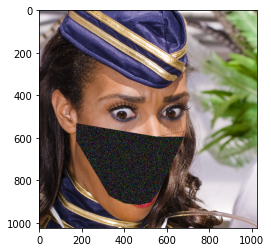

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 269
best score was -0.20746519209603584
average score was -0.18036136072536424


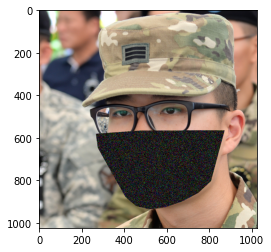

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 270
best score was 0.020767951417596315
average score was 0.03370812973244108


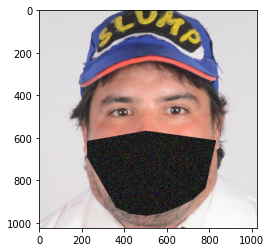

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 271
best score was 0.019469444362949506
average score was 0.027964318204553106


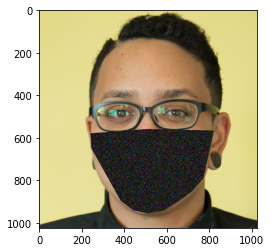

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 272
best score was -0.01984236199793103
average score was 0.018457476703952924


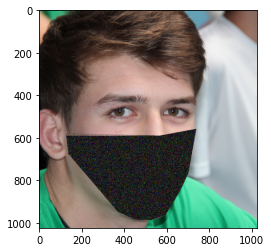

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 273
best score was -0.6866899863613666
average score was -0.6654317388089961


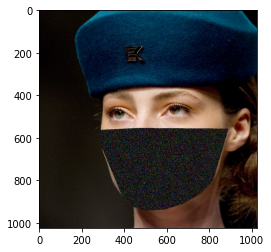

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 274
best score was -0.6904173429541807
average score was -0.6705856729698643


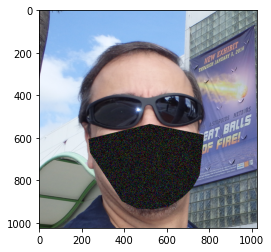

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 275
best score was -0.6923169827196022
average score was -0.6819526290628335


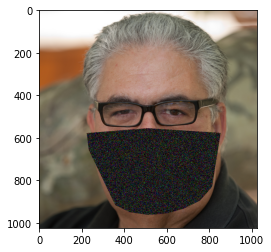

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 276
best score was -0.2154655142734924
average score was -0.20017707190021664


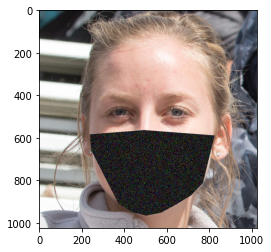

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 277
best score was -0.2154655142734924
average score was -0.2058702592164754


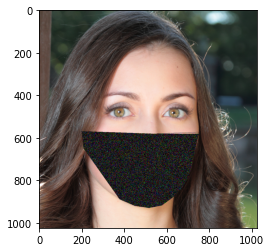

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 278
best score was -0.2154655142734924
average score was -0.21155325413847756


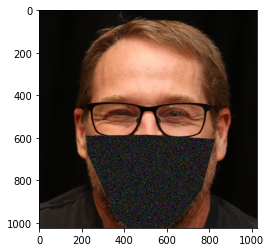

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 279
best score was -0.42206330330059744
average score was -0.4136874201981805


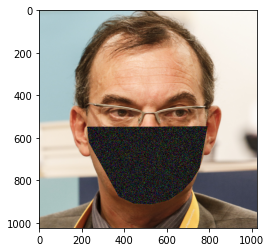

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 280
best score was -0.42206330330059744
average score was -0.4166906796980482


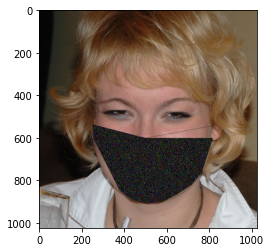

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 281
best score was -0.4228176596848748
average score was -0.41969041258976675


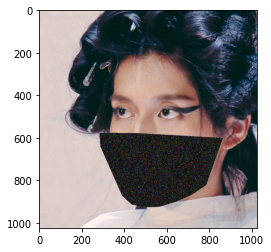

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 282
best score was -0.037622698668980714
average score was -0.030784675006413575


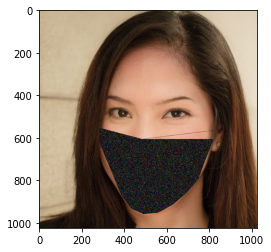

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 283
best score was -0.037622698668980714
average score was -0.03383136642410767


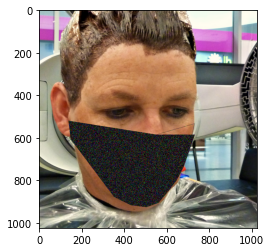

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 284
best score was -0.05686633638972453
average score was -0.03886247528030884


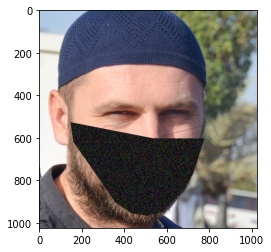

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 285
best score was -0.01602436721987373
average score was 0.024333381447525358


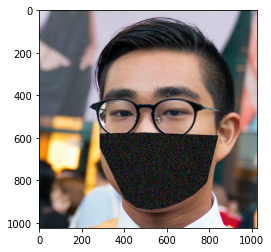

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 286
best score was -0.01602436721987373
average score was 0.010360701673558886


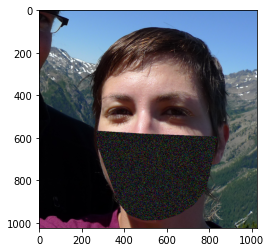

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 287
best score was -0.03276001643027682
average score was 0.008507472058691401


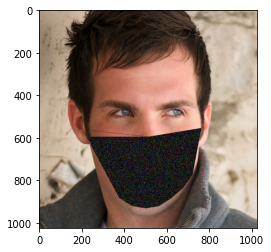

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 288
best score was -0.6825891021997212
average score was -0.6598392025662756


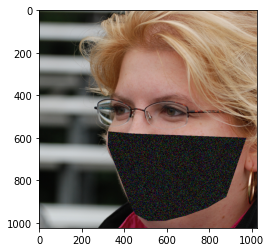

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 289
best score was -0.6825891021997212
average score was -0.6646140011210266


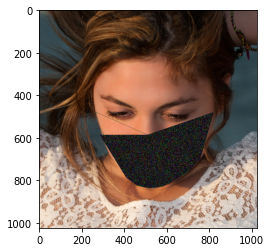

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 290
best score was -0.6822787225253949
average score was -0.6713729894194302


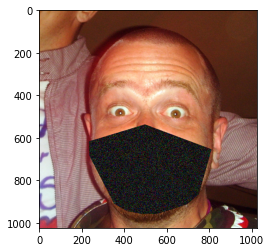

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 291
best score was -0.6196873508978468
average score was -0.5928393853805924


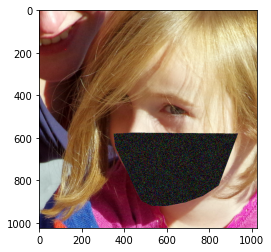

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 292
best score was -0.6196873508978468
average score was -0.6027684001222773


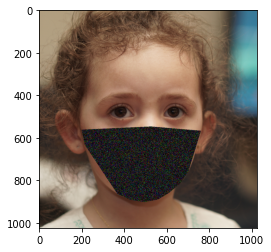

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 293
best score was -0.627661419221618
average score was -0.59750154843813


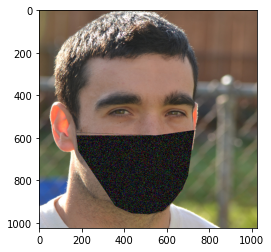

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 294
best score was -0.2059300901558682
average score was -0.1929011307226305


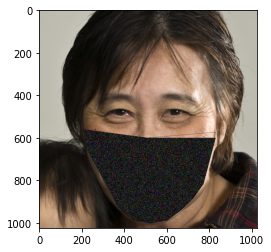

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 295
best score was -0.2293080649839525
average score was -0.1981435877150977


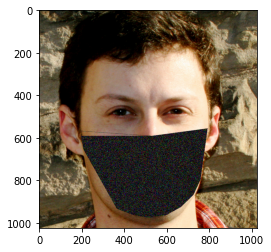

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 296
best score was -0.2293080649839525
average score was -0.21271134039428677


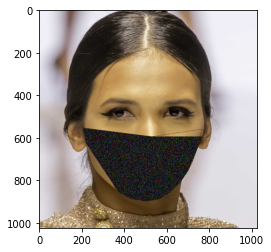

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 297
best score was -0.25971694441516285
average score was -0.24189373504995393


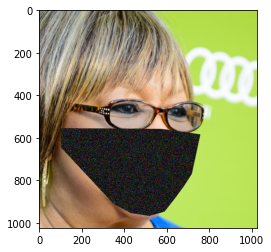

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 298
best score was -0.25971694441516285
average score was -0.24932262949028694


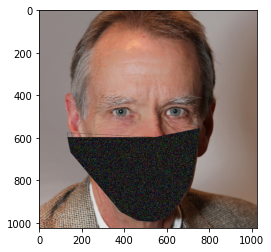

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 299
best score was -0.2641859417347023
average score was -0.2527076567399411


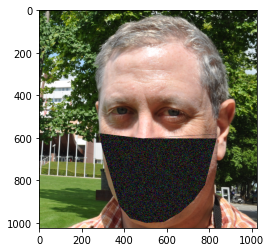

In [ ]:
#Supervisor script for project

nPopulation = 8  #choose multiples of 4 to make it work
nFacesTestPerGen = 3
nGenerations = 300


sampling = random.choices(faceList,k = nFacesTestPerGen) #use same faces each time for better tracking between generations
#starting with basic case of noise images and pixel by pixel mutation
#initialize the genes

genesFullPopulation = np.zeros((1024,1024,3,nPopulation))
pltIdx = 0
for ii in range(0,nPopulation):
  genesFullPopulation[:,:,:,ii] = create_image(1024,1024)


#start generation look here
bestScore = np.zeros((nGenerations))
worstScore = np.zeros((nGenerations))

for kk in range(0,nGenerations):

  #pull n faces 
  #sampling = random.choices(faceList,k = nFacesTestPerGen) #putting this outside for loop for now, but it should add regularization if included
  
  if pltIdx == 0:
    sampling = random.choices(faceList,k = nFacesTestPerGen) #putting this outside for loop for now, but it should add regularization if included
    faces = np.zeros((1024,1024,3,nFacesTestPerGen))


  for ii in range(0,nFacesTestPerGen):
    imgStr = './faceImages/02000/' + sampling[ii]
    faces[:,:,:,ii] = cv2.imread(imgStr)[...,::-1]



  masks = genesFullPopulation #for CPPN this will change

  #apply the mask to the faces and score them
  scores = np.zeros((nFacesTestPerGen,nPopulation))
  for jj in range(0,nPopulation):
    print('scoring mask ' + str(jj))
    for ii in range(0,nFacesTestPerGen):
      masked = applyFaceMask(faces[:,:,:,ii],masks[:,:,:,jj])
      scores[ii,jj] = faceScoreHOG(masked)
      
  avgScore = np.mean(scores,axis=0)

  #sort by best
  sortOrder = np.argsort(avgScore)
  sortedGenes = genesFullPopulation[:,:,:,sortOrder]

  bestScore[kk] = np.min(avgScore)
  worstScore[kk] = np.max(avgScore)

  #reproduce the best 50%
  for ii in range(0,int(nPopulation/2),2):
    
    C,D = reproduce(sortedGenes[:,:,:,ii],sortedGenes[:,:,:,ii+1])
    sortedGenes[:,:,:,(ii+int(nPopulation/2))] = C
    sortedGenes[:,:,:,(ii+int(nPopulation/2)+1)] = D 


  #mutate 5% of the population by 10%
  mutationPercent = np.random.rand(nPopulation)<0.05
  p = 0.1
  for ii in range(0,int(sum(1.0*mutationPercent))):
    sortedGenes[:,:,:,ii] = mutate(sortedGenes[:,:,:,ii],p)

  #restart the thingy
  genesFullPopulation = sortedGenes
  print('done with generation ' + str(kk))

  
  print('best score was ' + str(bestScore[kk]))
  print('average score was ' + str(np.average(avgScore)))
  masked = applyFaceMask(faces[:,:,:,pltIdx],masks[:,:,:,0])
  pltIdx = (pltIdx + 1) % nFacesTestPerGen

  
  plt.figure()
  plt.imshow(masked)
  plt.show()

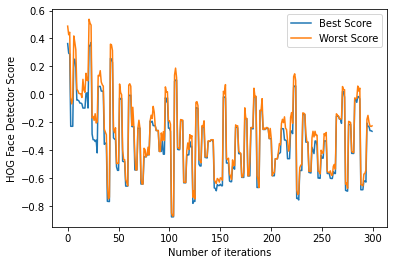

In [ ]:
plt.plot(bestScore)
plt.plot(worstScore)
plt.ylabel("HOG Face Detector Score")
plt.xlabel('Number of iterations')
plt.legend(['Best Score','Worst Score'])

Make some HOG images to show what is going on 

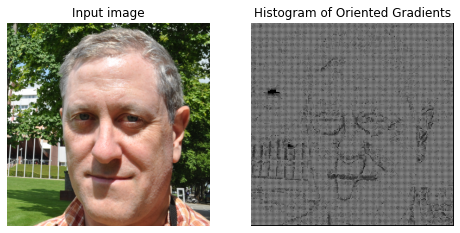

In [ ]:
from skimage.feature import hog
from skimage import data, color, exposure

image = faces[:,:,:,2].astype(np.uint8)
fd, hog_image = hog(image, orientations=16, pixels_per_cell=(6,6),
                    cells_per_block=(4, 4), visualize=True, multichannel=True)


plt.figure(figsize=(8, 4))

plt.subplot(121).set_axis_off()
plt.imshow(image)
plt.title('Input image')


# Rescale histogram for better display
hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 0.02))

plt.subplot(122).set_axis_off()
plt.imshow(hog_image_rescaled, cmap=plt.cm.gray)
plt.title('Histogram of Oriented Gradients')
plt.show()

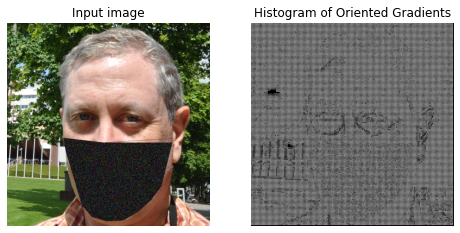

In [ ]:
image = masked
fd, hog_image = hog(image, orientations=16, pixels_per_cell=(6,6),
                    cells_per_block=(4, 4), visualize=True, multichannel=True)


plt.figure(figsize=(8, 4))

plt.subplot(121).set_axis_off()
plt.imshow(image)
plt.title('Input image')


# Rescale histogram for better display
hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 0.02))

plt.subplot(122).set_axis_off()
plt.imshow(hog_image_rescaled, cmap=plt.cm.gray)
plt.title('Histogram of Oriented Gradients')
plt.show()

Now run it again with the CPPN generation

In [ ]:
#Supervisor script for project
#redoing with cppn
import numpy

nPopulation = 8  #choose multiples of 4 to make it work
nFacesTestPerGen = 5 #started at 5
nGenerations = 30

pltIdx = 0

sampling = random.choices(faceList,k = nFacesTestPerGen) #use same faces each time for better tracking between generations
#starting with basic case of noise images and pixel by pixel mutation
#initialize the genes

genesFullPopulation = np.zeros((1024,1024,3,nPopulation))


L = 7               # number of layers
H = 32              # hidden layer size
O = 3               # O=3 for RGB, O=1 for grayscale
shift = numpy.random.randn(2,nPopulation)     # off center
WI = numpy.random.randn(O,H,nPopulation)


W = numpy.random.randn(H, H, L-1,nPopulation)

WO = numpy.random.randn(H, O,nPopulation)

#results = cppnImage(WI,W,WO,shift)
masks = np.zeros((1024,1024,3,nPopulation))




#start generation look here
bestScore = np.zeros((nGenerations))
worstScore = np.zeros((nGenerations))


scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 0
best score was -0.6736919797396248
average score was -0.32384656748242224


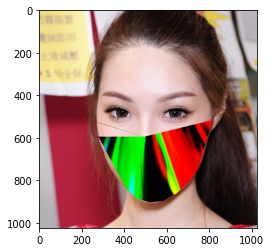

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 1
best score was -0.6736919797396248
average score was -0.3522376525634966


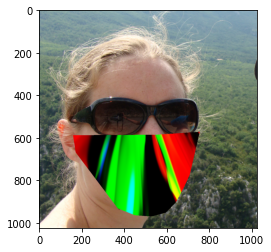

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 2
best score was -0.6736919797396248
average score was -0.48712935479755204


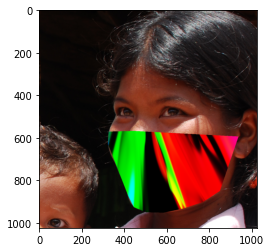

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 3
best score was -0.76908032843851
average score was -0.7361128563811731


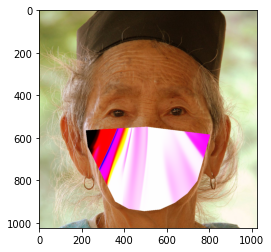

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 4
best score was -0.76908032843851
average score was -0.7269418802847217


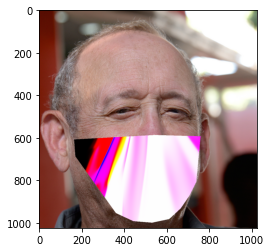

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 5
best score was -0.76908032843851
average score was -0.7409939633796365


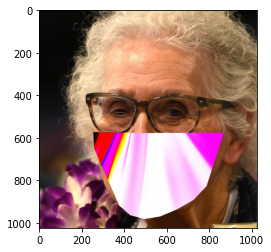

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 6
best score was -0.8061962913084243
average score was -0.7161015262810602


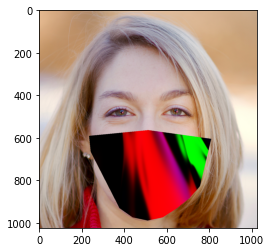

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 7
best score was -0.8061962913084243
average score was -0.7306331784137303


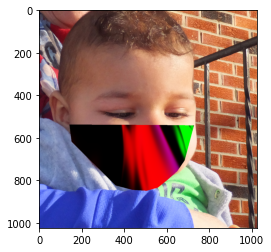

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 8
best score was -0.8695611149676853
average score was -0.7869388054418777


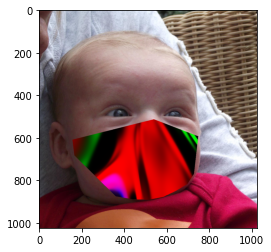

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 9
best score was -0.6768753731415681
average score was -0.46570134850074385


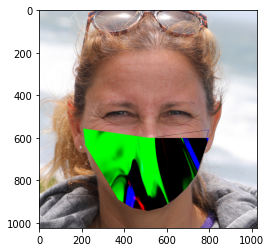

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 10
best score was -0.7836398201123461
average score was -0.5261531241995303


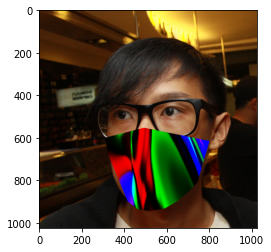

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 11
best score was -0.7836398201123461
average score was -0.4539827255541555


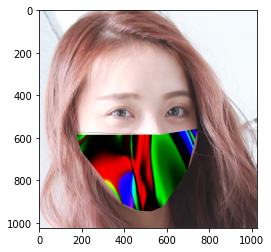

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 12
best score was -0.8735507945282363
average score was -0.6266462630747349


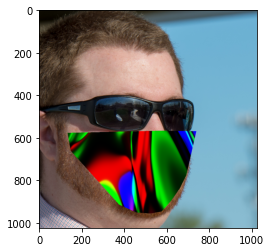

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 13
best score was -0.8735507945282363
average score was -0.6784756658270937


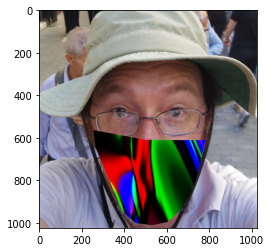

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 14
best score was -0.8735507945282363
average score was -0.6256376819313592


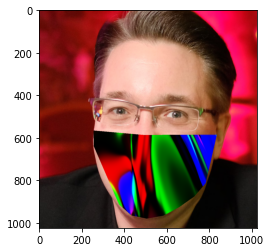

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 15
best score was -0.390782490236335
average score was -0.333357557518058


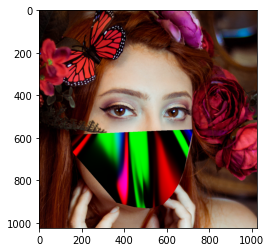

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 16
best score was -0.390782490236335
average score was -0.35451632227775753


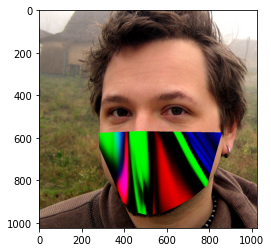

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 17
best score was -0.417202209296597
average score was -0.33466431544813213


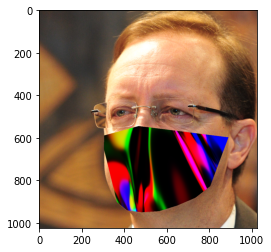

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 18
best score was -0.5201000853489318
average score was -0.3601586306204875


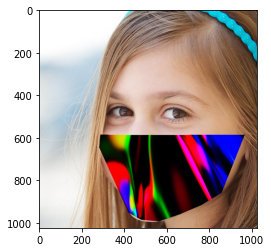

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 19
best score was -0.5201000853489318
average score was -0.4649367117991526


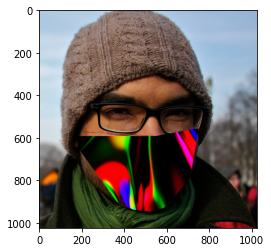

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 20
best score was -0.5201000853489318
average score was -0.38964669745271197


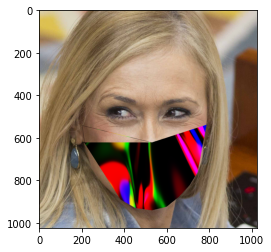

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 21
best score was -0.5497435094979092
average score was -0.3137865688565255


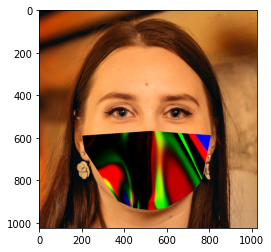

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 22
best score was -0.6052865857716658
average score was -0.45646312379392734


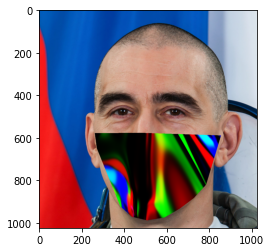

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 23
best score was -0.6052865857716658
average score was -0.4386311263103364


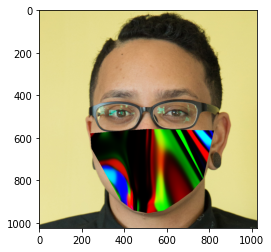

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 24
best score was -0.6737271185575083
average score was -0.5643063999140664


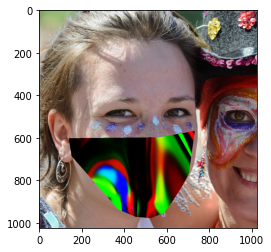

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 25
best score was -0.6737271185575083
average score was -0.6440164144720556


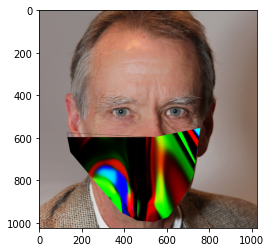

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 26
best score was -0.6737271185575083
average score was -0.640368690179298


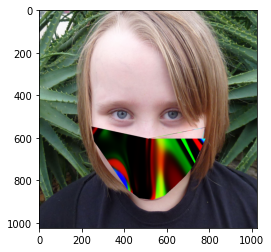

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 27
best score was -0.39816017599780446
average score was -0.3394944414556197


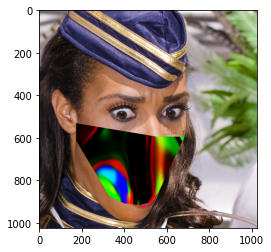

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 28
best score was -0.39816017599780446
average score was -0.39816017599780446


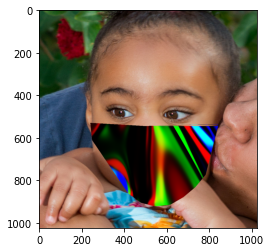

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 29
best score was -0.39816017599780446
average score was -0.34408044269285315


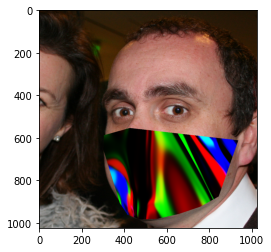

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 30
best score was -0.5167386820647467
average score was -0.5167386820647467


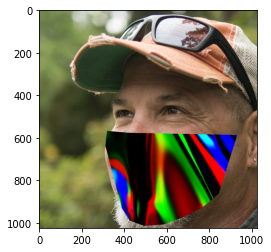

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 31
best score was -0.5167386820647467
average score was -0.4924391498896826


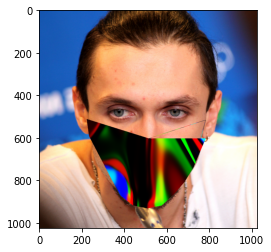

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 32
best score was -0.5167386820647467
average score was -0.4882197172178178


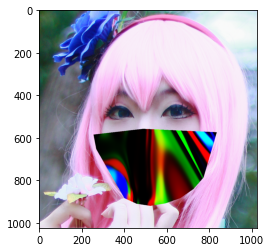

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 33
best score was -0.6647357498489582
average score was -0.6460860453812172


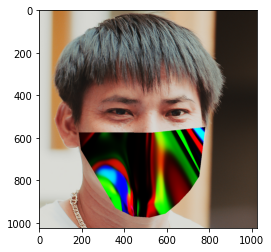

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 34
best score was -0.6647357498489582
average score was -0.6647357498489582


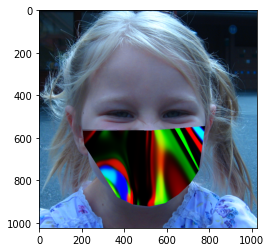

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 35
best score was -0.6647357498489582
average score was -0.6647357498489582


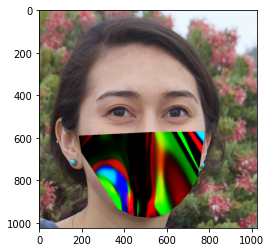

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 36
best score was -0.6697075104448219
average score was -0.6697075104448219


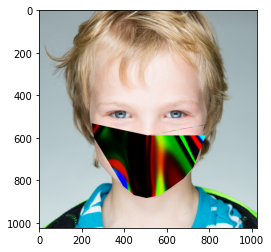

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 37
best score was -0.6697075104448219
average score was -0.6329655875047249


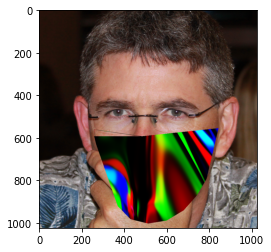

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 38
best score was -0.6697075104448219
average score was -0.6342672112285741


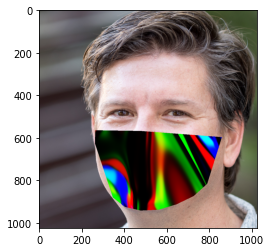

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 39
best score was -0.6778996710202638
average score was -0.5476567754503312


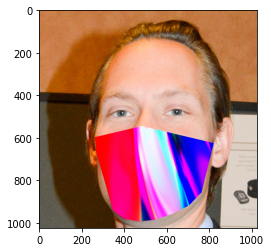

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 40
best score was -0.6778996710202638
average score was -0.604460543866978


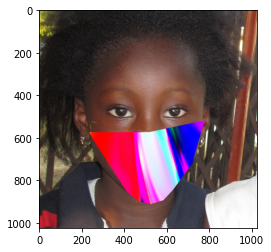

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 41
best score was -0.6778996710202638
average score was -0.5502875714319455


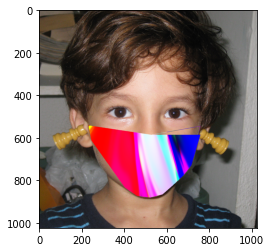

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 42
best score was -0.7323234844762213
average score was -0.5732215828625908


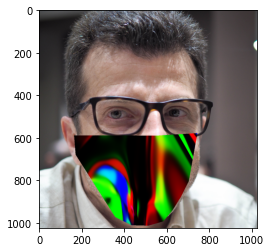

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 43
best score was -0.7323234844762213
average score was -0.694391295130127


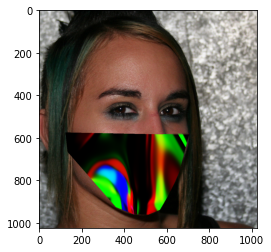

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 44
best score was -0.7323234844762213
average score was -0.656315689101888


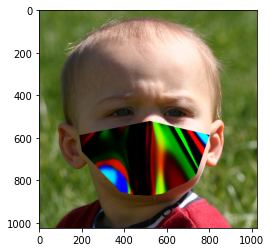

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 45
best score was -0.8319615280542462
average score was -0.8319615280542462


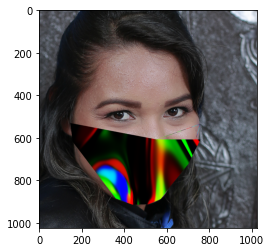

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 46
best score was -0.8319615280542462
average score was -0.7969450310780295


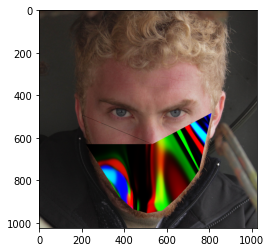

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 47
best score was -0.8319615280542462
average score was -0.8319615280542462


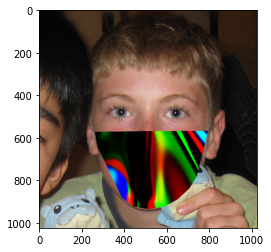

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 48
best score was -0.5901437379880523
average score was -0.5624520955447133


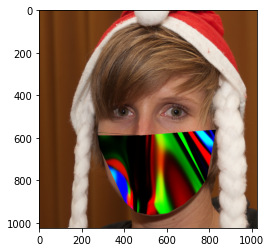

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 49
best score was -0.5901437379880523
average score was -0.5901437379880523


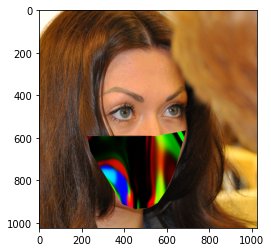

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 50
best score was -0.5901437379880523
average score was -0.5901437379880523


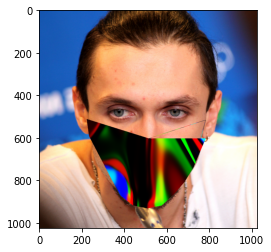

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 51
best score was -0.6982646024086233
average score was -0.656424110296788


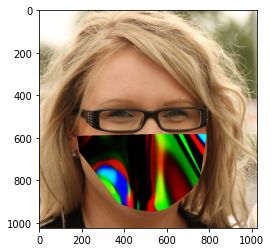

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 52
best score was -0.6982646024086233
average score was -0.6822341453792611


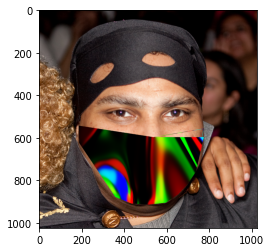

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 53
best score was -0.6982646024086233
average score was -0.6982646024086233


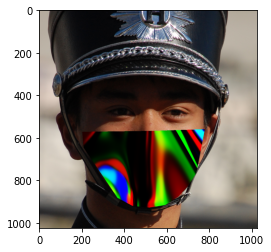

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 54
best score was -0.7013766968415193
average score was -0.6921898463526438


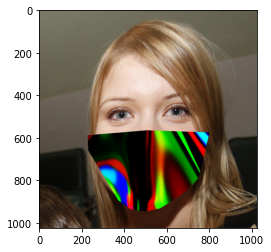

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 55
best score was -0.7013766968415193
average score was -0.7013766968415193


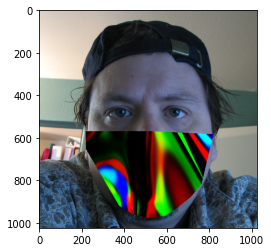

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 56
best score was -0.7013766968415193
average score was -0.680315933528675


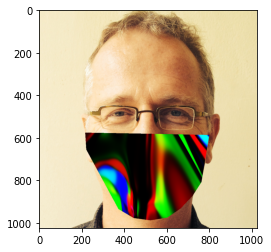

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7
done with generation 57
best score was -0.6738162742684722
average score was -0.6555644801062923


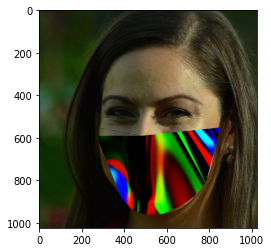

scoring mask 0
scoring mask 1
scoring mask 2
scoring mask 3
scoring mask 4
scoring mask 5
scoring mask 6
scoring mask 7


In [ ]:



for kk in range(0,nGenerations):

  #pull n faces every n cycles - keeps faces consistent for n times
  if pltIdx == 0:
    sampling = random.choices(faceList,k = nFacesTestPerGen) #putting this outside for loop for now, but it should add regularization if included
    faces = np.zeros((1024,1024,3,nFacesTestPerGen))


    for ii in range(0,nFacesTestPerGen):
      imgStr = './faceImages/02000/' + sampling[ii]
      faces[:,:,:,ii] = cv2.imread(imgStr)[...,::-1]




  #apply the mask to the faces and score them
  scores = np.zeros((nFacesTestPerGen,nPopulation))
  for jj in range(0,nPopulation):
    masks[:,:,:,jj] = cppnImage(WI[:,:,jj],W[:,:,:,jj],WO[:,:,jj],shift[:,jj])
    print('scoring mask ' + str(jj))
    for ii in range(0,nFacesTestPerGen):
      masked = applyFaceMask(faces[:,:,:,ii],masks[:,:,:,jj])
      scores[ii,jj] = faceScoreHOG(masked)
      
  avgScore = np.mean(scores,axis=0)

  #sort by best
  sortOrder = np.argsort(avgScore)


  sortedWI = WI[:,:,sortOrder]
  sortedW = W[:,:,:,sortOrder]
  sortedWO = WO[:,:,sortOrder]
  sortedShift = shift[:,sortOrder]
  masks = masks[:,:,:,sortOrder] #gotta sort this for the update plot to make sense

  bestScore[kk] = np.min(avgScore)
  worstScore[kk] = np.max(avgScore)

  #reproduce the best 50%
  for ii in range(0,int(nPopulation/2),2):
    

    C,D = reproduce(sortedWI[:,:,ii],sortedWI[:,:,ii+1])
    sortedWI[:,:,(ii+int(nPopulation/2))] = C
    sortedWI[:,:,(ii+int(nPopulation/2)+1)] = D 


    C,D = reproduce(sortedW[:,:,:,ii],sortedW[:,:,:,ii+1])
    sortedW[:,:,:,(ii+int(nPopulation/2))] = C
    sortedW[:,:,:,(ii+int(nPopulation/2)+1)] = D 


    C,D = reproduce(sortedWO[:,:,ii],sortedWO[:,:,ii+1])
    sortedWO[:,:,(ii+int(nPopulation/2))] = C
    sortedWO[:,:,(ii+int(nPopulation/2)+1)] = D 

    C,D = reproduce(sortedShift[:,ii],sortedShift[:,ii+1])
    sortedShift[:,(ii+int(nPopulation/2))] = C
    sortedShift[:,(ii+int(nPopulation/2)+1)] = D 





  #mutate 10% of the population by 20%
  #skip the top scoring one 
  mutationPercent = np.random.rand(nPopulation - 1)<0.1
  p = 0.2

  vec = np.linspace(1,nPopulation - 1, nPopulation - 1)
  mutateMe = vec[mutationPercent]

  for ii in range(0,len(mutateMe)):

    nMut = int(mutateMe[ii])

    sortedWI[:,:,nMut] = mutate(sortedWI[:,:,nMut],p)
    sortedW[:,:,:,nMut] = mutate(sortedW[:,:,:,nMut],p)
    sortedWO[:,:,nMut] = mutate(sortedWO[:,:,nMut],p)
    sortedShift[:,nMut] = mutate(sortedShift[:,nMut],p)
  #restart the thingy
  WI = sortedWI
  W = sortedW
  WO = sortedWO
  shift = sortedShift


  print('done with generation ' + str(kk))
  print('best score was ' + str(bestScore[kk]))
  print('average score was ' + str(np.average(avgScore)))
  masked = applyFaceMask(faces[:,:,:,pltIdx],masks[:,:,:,0])
  pltIdx = (pltIdx + 1) % nFacesTestPerGen

  
  plt.figure()
  plt.imshow(masked)
  plt.show()

In [ ]:

plt.plot(bestScore)
plt.plot(worstScore)
plt.ylabel("HOG Face Detector Score")
plt.xlabel('Number of iterations')
plt.legend(['Best Score','Worst Score'])

NameError: ignored

Again, make the HOG images

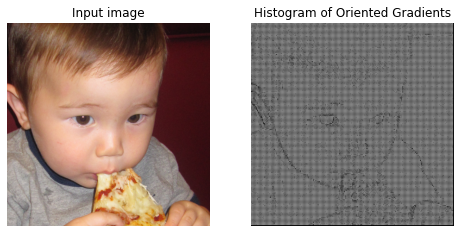

In [ ]:

image = faces[:,:,:,4].astype(np.uint8)
fd, hog_image = hog(image, orientations=16, pixels_per_cell=(6,6),
                    cells_per_block=(4, 4), visualize=True, multichannel=True)


plt.figure(figsize=(8, 4))

plt.subplot(121).set_axis_off()
plt.imshow(image)
plt.title('Input image')


# Rescale histogram for better display
hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 0.02))

plt.subplot(122).set_axis_off()
plt.imshow(hog_image_rescaled, cmap=plt.cm.gray)
plt.title('Histogram of Oriented Gradients')
plt.show()

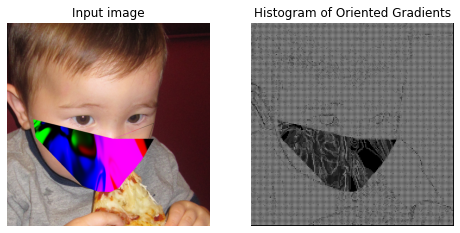

In [ ]:
image = masked
fd, hog_image = hog(image, orientations=16, pixels_per_cell=(6,6),
                    cells_per_block=(4, 4), visualize=True, multichannel=True)


plt.figure(figsize=(8, 4))

plt.subplot(121).set_axis_off()
plt.imshow(image)
plt.title('Input image')


# Rescale histogram for better display
hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 0.02))

plt.subplot(122).set_axis_off()
plt.imshow(hog_image_rescaled, cmap=plt.cm.gray)
plt.title('Histogram of Oriented Gradients')
plt.show()

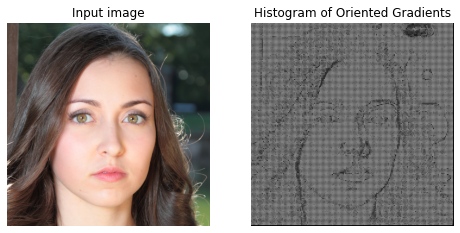

In [ ]:

image = faces[:,:,:,4].astype(np.uint8)
fd, hog_image = hog(image, orientations=16, pixels_per_cell=(6,6),
                    cells_per_block=(16,16), visualize=True, multichannel=True)


plt.figure(figsize=(8, 4))

plt.subplot(121).set_axis_off()
plt.imshow(image)
plt.title('Input image')


# Rescale histogram for better display
hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 0.01))

plt.subplot(122).set_axis_off()
plt.imshow(hog_image_rescaled, cmap=plt.cm.gray)
plt.title('Histogram of Oriented Gradients')
plt.show()

Download genetics for fun

In [ ]:
from google.colab import files
np.save('WI')
np.save('W')
np.save('WO')
np.save('shift')

files.download('WI.npy')
files.download('W.npy')
files.download('WO.npy')
files.download('shift.npy')

In [ ]:
plt.plot(bestScore)
plt.plot(worstScore)
plt.ylabel("HOG Face Detector Score")
plt.xlabel('Number of iterations')
plt.legend(['Best Score','Worst Score'])

In [ ]:
masked = applyFaceMask(faces[:,:,:,0],masks[:,:,:,0])
plt.imshow(masked)

Playing with CPPN for the presentation

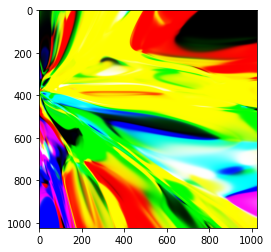

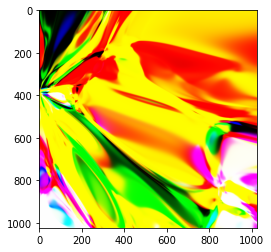

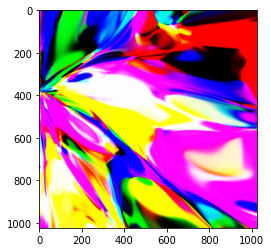

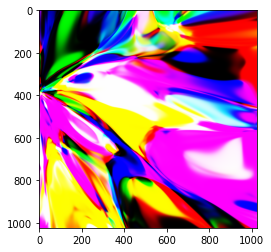

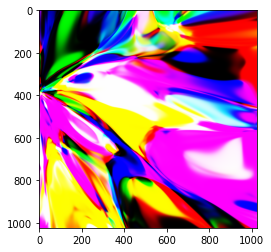

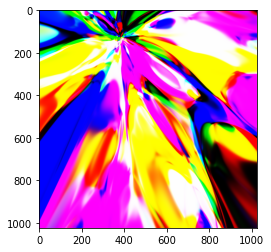

In [ ]:
L = 7               # number of layers
H = 32              # hidden layer size
O = 3               # O=3 for RGB, O=1 for grayscale
shift = [.25,1]     # off center
WI = numpy.random.randn(O,H)


W = numpy.random.randn(H, H, L-1)

WO = numpy.random.randn(H, O)

results = cppnImage(WI,W,WO,shift)

plt.imshow(results)
plt.show()

plt.figure()

WI = mutate(WI,0.05)

results = cppnImage(WI,W,WO,shift)

plt.imshow(results)
plt.show()


W = mutate(W,0.05)



results = cppnImage(WI,W,WO,shift)

plt.imshow(results)
plt.show()



WO = mutate(WO,0.05)


results = cppnImage(WI,W,WO,shift)

plt.imshow(results)
plt.show()





shift = mutate(np.asarray(shift),0.05)


results = cppnImage(WI,W,WO,shift)

plt.imshow(results)
plt.show()




shift = [.75,.25]  


results = cppnImage(WI,W,WO,shift)

plt.imshow(results)
plt.show()






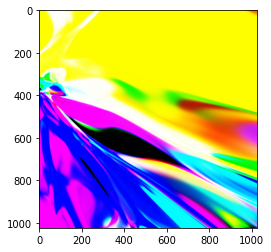

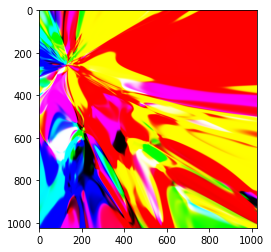

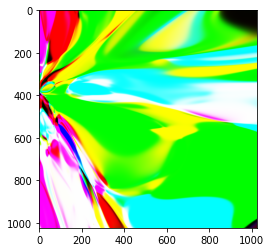

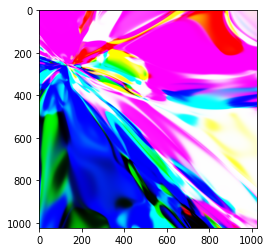

In [ ]:
L = 7               # number of layers
H = 32              # hidden layer size
O = 3               # O=3 for RGB, O=1 for grayscale
shifta = np.asarray([.25,1])     # off center
WIa = numpy.random.randn(O,H)


Wa = numpy.random.randn(H, H, L-1)

WOa = numpy.random.randn(H, O)


shiftb = np.asarray([.5,.75])     # off center
WIb = numpy.random.randn(O,H)


Wb = numpy.random.randn(H, H, L-1)

WOb = numpy.random.randn(H, O)

results = cppnImage(WIa,Wa,WOa,shifta)

plt.imshow(results)
plt.show()

plt.figure()

results = cppnImage(WIb,Wb,WOb,shiftb)

plt.imshow(results)
plt.show()


WIc, WId = reproduce(WIa,WIb)
Wc, Wd = reproduce(Wa,Wb)
WOc, WOd = reproduce(WOa, WOb)
shiftc, shiftd = reproduce(shifta, shiftb)


plt.figure()

results = cppnImage(WIc,Wc,WOc,shiftc)

plt.imshow(results)
plt.show()


plt.figure()

results = cppnImage(WId,Wd,WOd,shiftd)

plt.imshow(results)
plt.show()